In [1]:
import mira
import anndata
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
mira.utils.wide_view()
from mira.plots.base import map_plot, plot_umap

In [69]:
rna_model = mira.topics.ExpressionTopicModel.load('data/preprocessing/models/2022-01-05_best_rna_model.pth')
rna_data = anndata.read_h5ad('data/preprocessing/aggregated/2022-01-05_rna_data.h5ad')

INFO:mira.topic_model.base:Moving model to CPU for inference.
INFO:mira.topic_model.base:Moving model to device: cpu


rna_model.set_params(**{'num_topics': 27, 'batch_size': 64, 'encoder_dropout': 0.010389395729241885, 'num_epochs': 39, 'beta': 0.9068527234323274, 'seed': 2848175038})
rna_model.fit(rna_data)

In [70]:
rna_model.predict(rna_data)
rna_model.get_hierarchical_umap_features(rna_data, box_cox=0.5)

Predicting latent vars: 100%|█████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:04<00:00,  9.18it/s]
INFO:mira.adata_interface.topic_model:Added key to obsm: X_topic_compositions
INFO:mira.adata_interface.topic_model:Added cols: topic_0, topic_1, topic_2, topic_3, topic_4, topic_5, topic_6, topic_7, topic_8, topic_9, topic_10, topic_11, topic_12, topic_13, topic_14, topic_15, topic_16, topic_17, topic_18, topic_19, topic_20, topic_21, topic_22, topic_23, topic_24, topic_25, topic_26
INFO:mira.adata_interface.topic_model:Fetching key X_topic_compositions from obsm
INFO:mira.adata_interface.core:Added key to obsm: X_umap_features
INFO:mira.adata_interface.topic_model:Added key to uns: topic_dendogram


In [71]:
rna_model._get_read_depth(rna_data)
rna_data.obs['log_total_counts'] = np.log(rna_data.obs.total_counts)

INFO:mira.adata_interface.core:Added cols to obs: model_read_scale


In [72]:
sc.pp.neighbors(rna_data, use_rep='X_umap_features', metric='manhattan')
sc.tl.umap(rna_data, min_dist = 0.1, negative_sample_rate=1)

In [73]:
rna_data = rna_data[rna_data.obsm['X_umap'][:,1] > 2]

In [74]:
rna_model.get_hierarchical_umap_features(rna_data, box_cox=0.6)
sc.pp.neighbors(rna_data, use_rep='X_umap_features', metric='manhattan')
sc.tl.umap(rna_data, min_dist = 0.1, negative_sample_rate=1)

INFO:mira.adata_interface.topic_model:Fetching key X_topic_compositions from obsm
INFO:mira.adata_interface.core:Added key to obsm: X_umap_features
INFO:mira.adata_interface.topic_model:Added key to uns: topic_dendogram


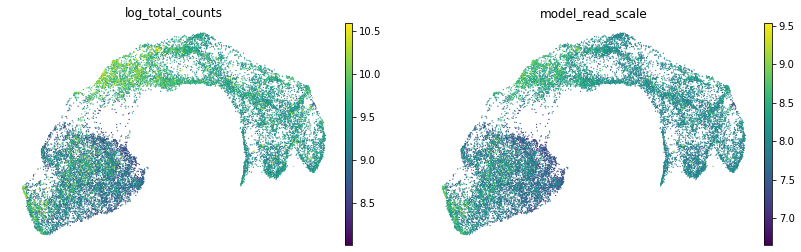

In [75]:
sc.pl.umap(rna_data, color = ['log_total_counts', 'model_read_scale'], frameon = False)

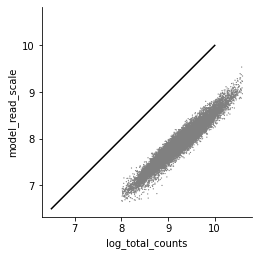

In [76]:
ax = sc.pl.scatter(rna_data, x = 'log_total_counts', y = 'model_read_scale', show = False)
ax.plot([6.5,10],[6.5,10], color = 'black')
ax.axis('square')
sns.despine()

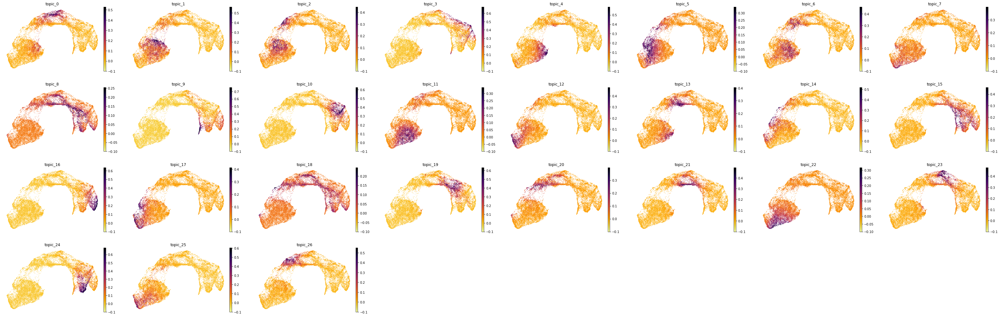

In [77]:
sc.pl.umap(rna_data, color = rna_model.topic_cols, **mira.pref.topic_umap(color_map='inferno_r'), vmin = -0.1)

In [78]:
rna_data.raw = rna_data

sc.pp.normalize_total(rna_data, target_sum=1e4)

rna_data.layers['normalized'] = rna_data.X
rna_data.X = rna_data.raw.to_adata().X

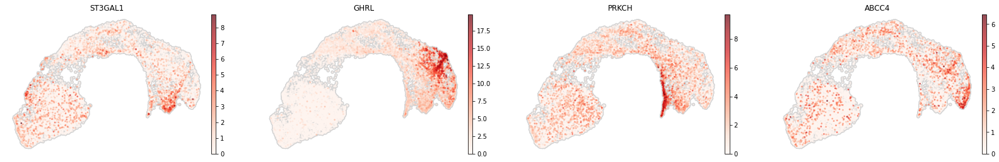

In [79]:
sc.pl.umap(rna_data, color = ['ST3GAL1','GHRL','PRKCH','ABCC4'], **mira.pref.raw_umap(), layer='normalized')

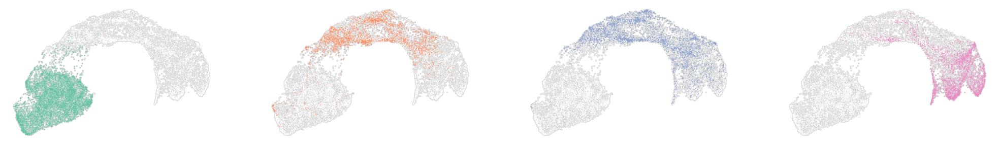

In [80]:
fig, ax = plt.subplots(1,4, figsize=(35,5))
for i, t in enumerate(map(str, [1,3,5,6])):
    sc.pl.umap(rna_data, na_color = 'white', ax = ax[i], show = False, add_outline=True, outline_width=(1.,0), outline_color=('lightgrey','white'), size = 5,
              frameon=False)
    sc.pl.umap(rna_data[rna_data.obs.time == 'PS' + t], na_color = sns.color_palette('Set2')[i], ax = ax[i], show = False, size = 8, frameon=False)

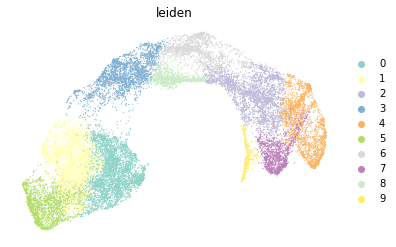

In [81]:
sc.tl.leiden(rna_data, resolution = 0.5)
sc.pl.umap(rna_data, color = 'leiden', palette = 'Set3', frameon=False)

In [82]:
rna_data.obs.leiden.to_csv('data/preprocessing/aggregated/rna_leiden.tsv',sep = '\t')

In [83]:
rna_model.post_topics(500)
rna_model.fetch_enrichments()

INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Norwegian', 1.0), ('Indonesian', 1.0)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Norwegian', 1.0), ('Indonesian', 1.0)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0),

INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Indonesian', 1.0), ('Swedish', 1.0), ('French', 1.0), ('Simple English', 1.0), ('Dutch', 0.9825)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Swedish', 1.0), ('French', 1.0), ('Indonesian', 1.0)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Indonesian', 1.0)

INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Indonesian', 1.0), ('Simple English', 1.0), ('Norwegian', 1.0)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 0.9889), ('Norwegian', 0.9833), ('Dutch', 0.9778), ('Polish', 0.975)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Swedish', 1.0), ('Finnish', 1.0), ('Indones

INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('French', 1.0), ('Dutch', 1.0), ('Italian', 1.0), ('Indonesian', 1.0), ('English', 0.99)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('Italian', 1.0), ('Swedish', 1.0), ('Indonesian', 1.0), ('French', 1.0), ('English', 0.99), ('Dutch', 0.99)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_no

INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Indonesian', 1.0), ('Norwegian', 1.0)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Norwegian', 1.0), ('Polish', 1.0), ('Indonesian', 1.0), ('Italian', 1.0)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Norwegian', 1.0), ('Swedish', 1.0), ('In

INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Indonesian', 1.0), ('French', 1.0), ('Dutch', 0.9619), ('Swedish', 0.9524)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Indonesian', 1.0), ('Italian', 1.0), ('German', 1.0), ('Swedish', 1.0), ('Norwegian', 1.0)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Lat

INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Indonesian', 1.0), ('Norwegian', 0.975)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('Italian', 1.0), ('French', 1.0), ('Swedish', 1.0), ('Norwegian', 1.0), ('English', 0.99), ('Dutch', 0.99)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('Italian', 1.0), ('Indonesian', 1.0), ('Simple English', 1.0), ('French', 

INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Indonesian', 1.0), ('Swedish', 1.0), ('Italian', 1.0)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Indonesian', 1.0), ('German', 1.0), ('Italian', 1.0)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Indonesian', 1.0), ('Norwegian', 1.0), ('Fre

INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('English', 1.0), ('Dutch', 1.0), ('Norwegian', 1.0), ('Polish', 1.0), ('Indonesian', 0.9841)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('Indonesian', 1.0), ('Finnish', 1.0), ('Norwegian', 1.0), ('Dutch', 0.9895), ('English', 0.9889), ('Swedish', 0.9474), ('German', 0.9444)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured c

INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('Polish', 0.9375), ('English', 0.902), ('French', 0.875), ('Dutch', 0.875), ('Portuguese', 0.8125), ('Finnish', 0.8125), ('Swedish', 0.8125), ('Italian', 0.7812), ('German', 0.75), ('Spanish', 0.6875), ('Norwegian', 0.625)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('French', 1.0), ('Italian', 1.0), ('Norwegian', 1.0), ('Indonesian', 1.0), ('Dutch', 0.9905), ('English', 0.9889)] using ascii
INFO:charset_normalizer:ascii is most likely 

INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('Italian', 1.0), ('Indonesian', 1.0), ('French', 1.0), ('English', 0.9895), ('Dutch', 0.9737)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of ['Latin Based']
INFO:charset_normalizer:We detected language [('Italian', 1.0), ('Norwegian', 1.0), ('French', 1.0), ('Indonesian', 1.0), ('English', 0.98), ('Dutch', 0.98), ('Polish', 0.9474)] using ascii
INFO:charset_normalizer:ascii is most likely the one. Stopping the process.
INFO:charset_normalizer:ascii passed initial chaos probing. Mean measured chaos is 0.000000 %
INFO:charset_normalizer:ascii should target any language(s) of [

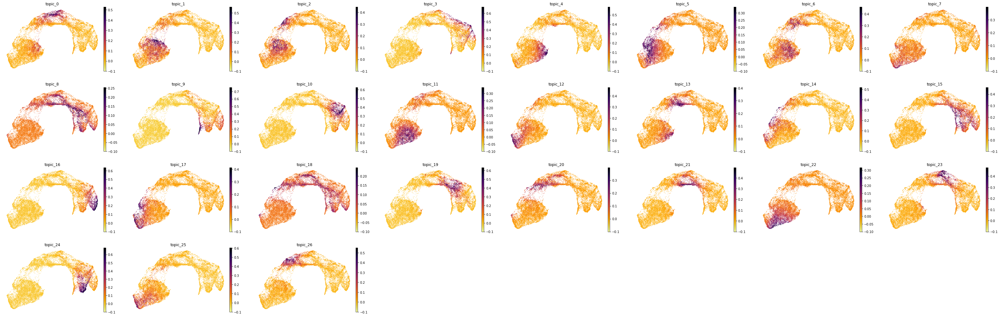

In [84]:
sc.pl.umap(rna_data, color = rna_model.topic_cols, **mira.pref.topic_umap(color_map='inferno_r'), vmin = -0.1)

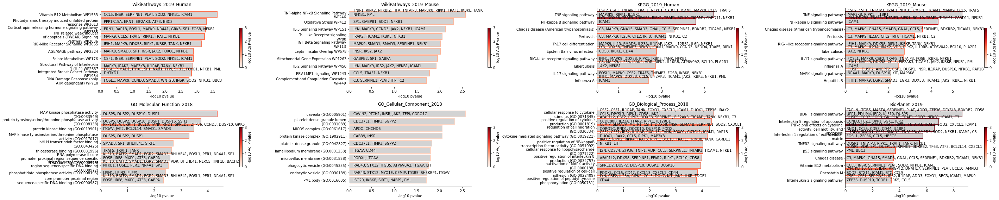

In [85]:
rna_model.plot_enrichments(6, pval_threshold=1e-3, plots_per_row=4, height=4)

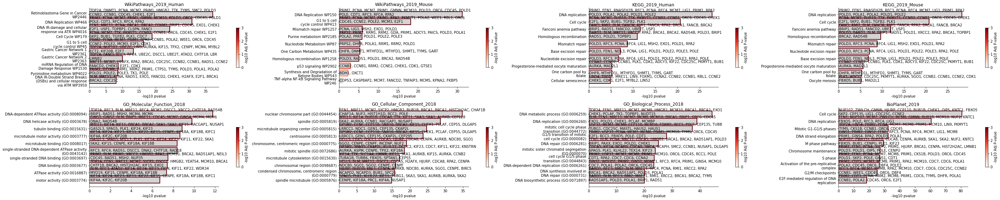

In [86]:
rna_model.plot_enrichments(12, pval_threshold=1e-3, plots_per_row=4, height=4)

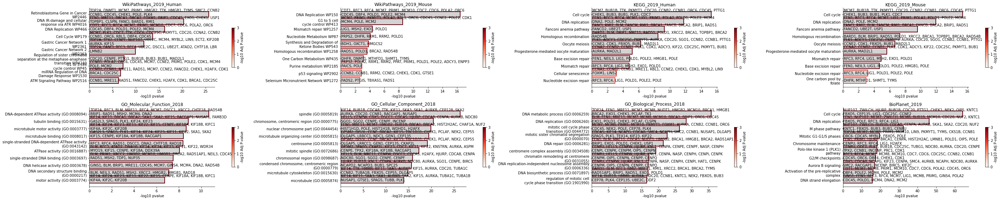

In [87]:
rna_model.plot_enrichments(25, pval_threshold=1e-3, plots_per_row=4, height=4)

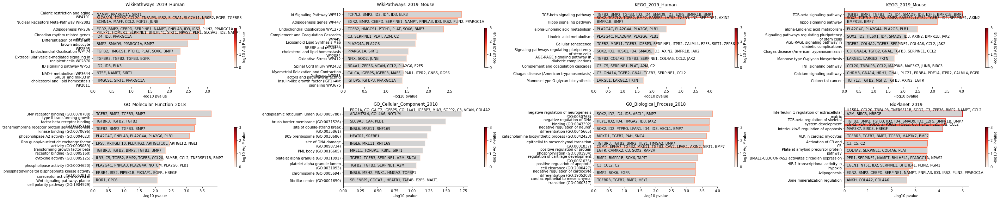

In [313]:
rna_model.plot_enrichments(0, pval_threshold=1e-3, plots_per_row=4, height=4)
plt.savefig('data/analysis/2022-01-11_Hippo+_rna_enrichments.svg')

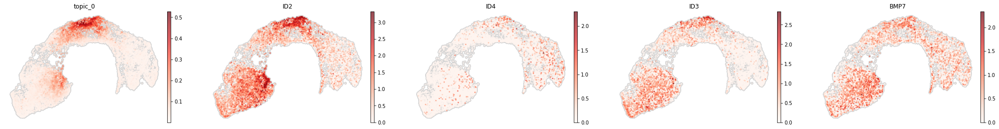

In [20]:
sc.pl.umap(rna_data, color = ['topic_0','ID2','ID4','ID3','BMP7'], **mira.pref.raw_umap())

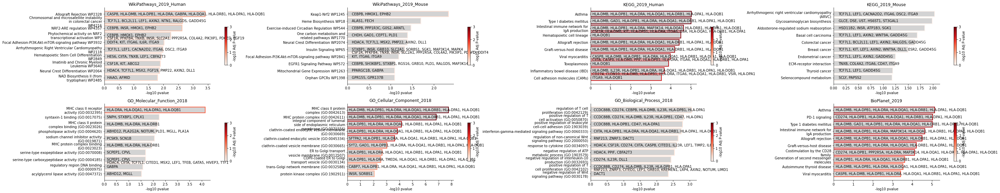

In [312]:
rna_model.plot_enrichments(13, pval_threshold=1e-3, plots_per_row=4, height=4)
plt.savefig('data/analysis/2022-01-11_Immune+_rna_enrichments.svg')

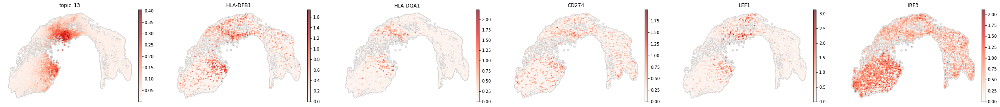

In [108]:
sc.pl.umap(rna_data, color = ['topic_13','HLA-DPB1','HLA-DQA1','CD274','LEF1','IRF3'], **mira.pref.raw_umap())

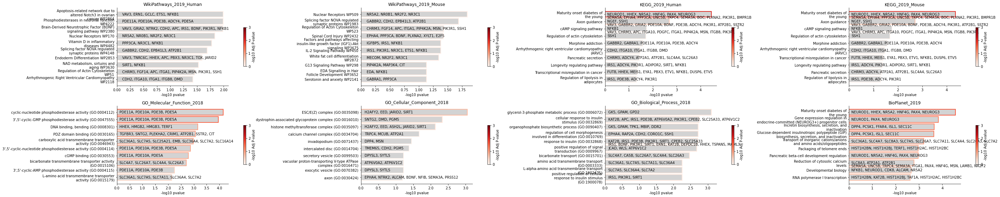

In [176]:
rna_model.plot_enrichments(19, pval_threshold=1e-3, plots_per_row=4, height=4)

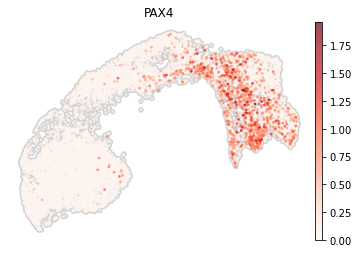

In [136]:
sc.pl.umap(rna_data, color = ['PAX4'], **mira.pref.raw_umap())

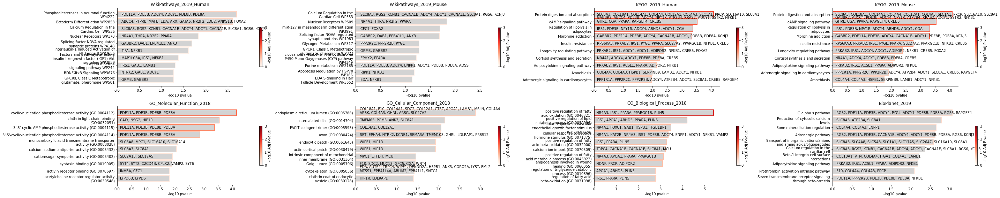

In [307]:
rna_model.plot_enrichments(10, pval_threshold=1e-3, plots_per_row=4, height=4, aspect=2.5)
plt.savefig('data/analysis/2022-11-01_GHRL+_rna_enrichments.svg')

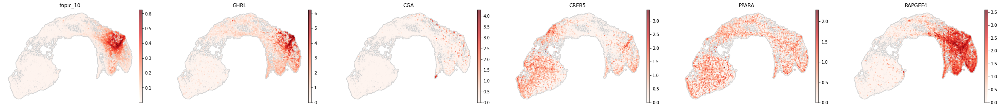

In [26]:
sc.pl.umap(rna_data, color = ['topic_10','GHRL','CGA','CREB5','PPARA','RAPGEF4'], **mira.pref.raw_umap())

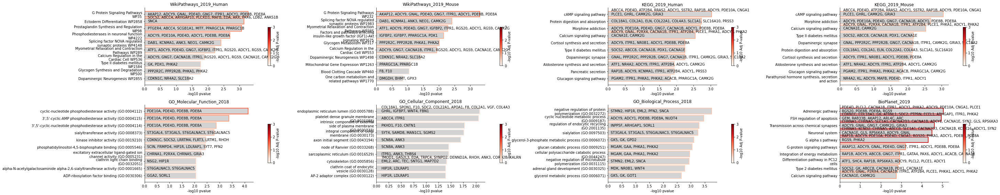

In [308]:
rna_model.plot_enrichments(16, pval_threshold=1e-3, plots_per_row=4, height=4)
plt.savefig('data/analysis/2022-01-11_PAX6_rna_enrichments.svg')

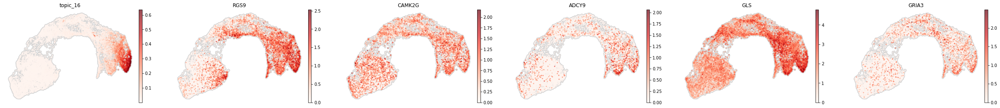

In [28]:
sc.pl.umap(rna_data, color = ['topic_16','RGS9','CAMK2G','ADCY9','GLS','GRIA3'], **mira.pref.raw_umap())

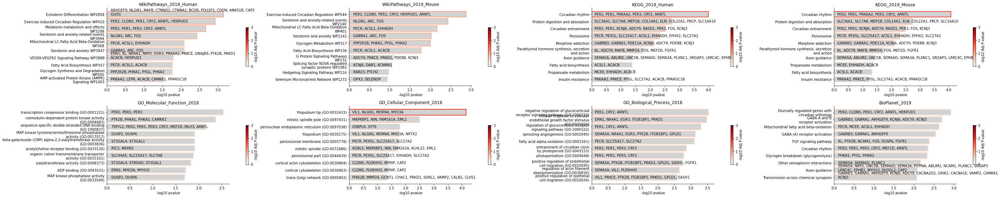

In [309]:
rna_model.plot_enrichments(24, pval_threshold=1e-3, plots_per_row=4, height=4)
plt.savefig('data/analysis/2022-01-11_MYO3A+_rna_enrichments.svg')

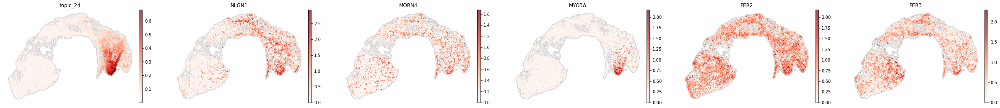

In [30]:
sc.pl.umap(rna_data, color = ['topic_24','NLGN1','MORN4','MYO3A','PER2','PER3'], **mira.pref.raw_umap())

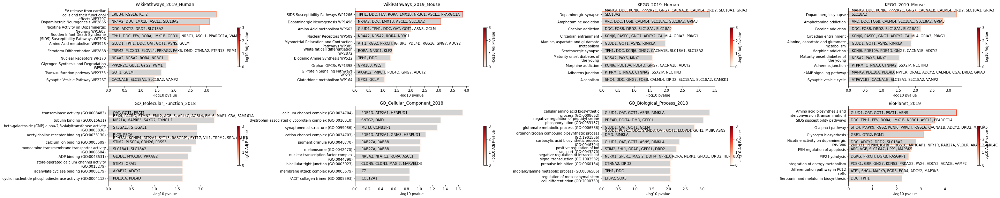

In [114]:
rna_model.plot_enrichments(9, pval_threshold=1e-3, plots_per_row=4, height=4)
plt.savefig('data/analysis/2022-01-11_ASCL1+_rna_enrichments.svg')

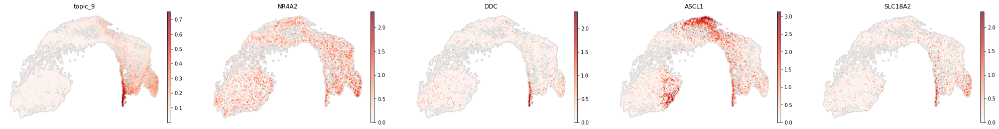

<Figure size 432x288 with 0 Axes>

In [310]:
sc.pl.umap(rna_data, color = ['topic_9','NR4A2','DDC','ASCL1','SLC18A2'], **mira.pref.raw_umap(size = 20))

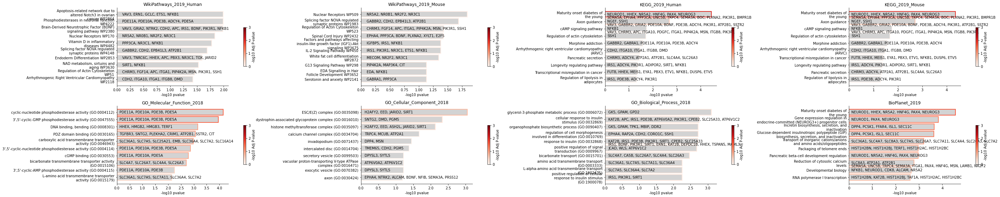

In [311]:
rna_model.plot_enrichments(19, pval_threshold=1e-3, plots_per_row=4, height=4)
plt.savefig('data/analysis/2022-01-11_NEUROG3+_rna_enrichments.svg')

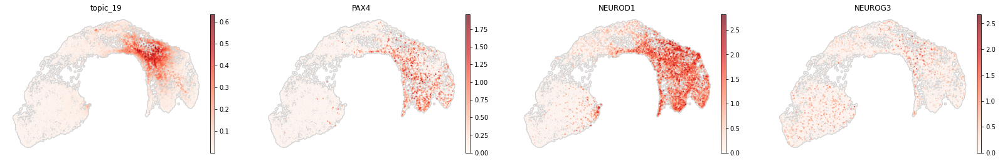

In [34]:
sc.pl.umap(rna_data, color = ['topic_19','PAX4','NEUROD1','NEUROG3'], **mira.pref.raw_umap(size = 20))

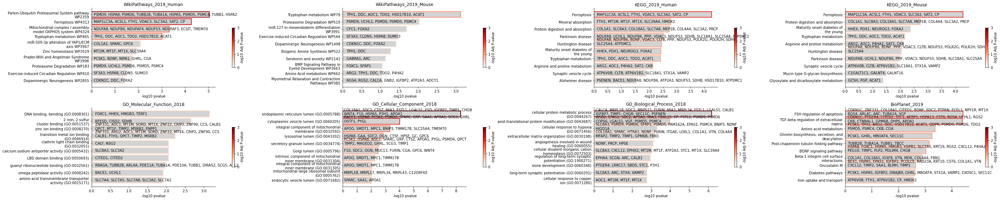

In [35]:
rna_model.plot_enrichments(3, pval_threshold=1e-3, plots_per_row=4, height=4)

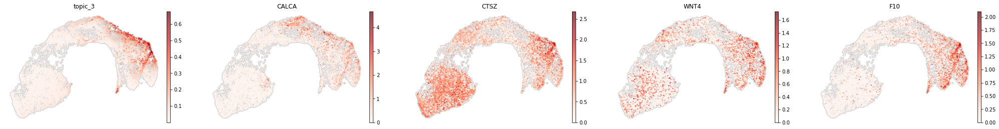

In [36]:
sc.pl.umap(rna_data, color = ['topic_3','CALCA','CTSZ','WNT4','F10'], **mira.pref.raw_umap(size = 20))

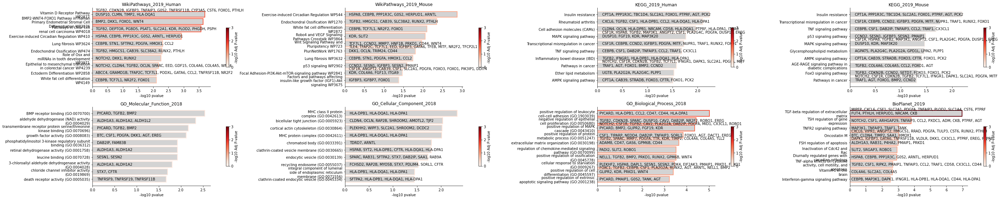

In [37]:
rna_model.plot_enrichments(26, pval_threshold=1e-3, plots_per_row=4, height=4)

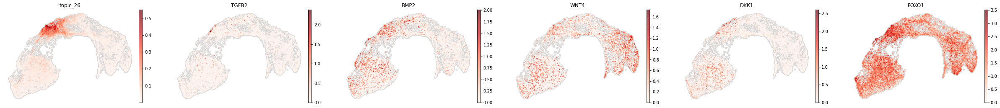

In [38]:
sc.pl.umap(rna_data, color = ['topic_26','TGFB2','BMP2','WNT4','DKK1','FOXO1'], **mira.pref.raw_umap(size = 20))

# Load in ATAC model

In [88]:
atac_model = mira.topics.AccessibilityTopicModel.load('data/preprocessing/models/2022-01-11_best_atac_model.pth')
atac_data = anndata.read_h5ad('data/preprocessing/aggregated/2022-01-06_atac_data.h5ad')

INFO:mira.topic_model.base:Moving model to CPU for inference.
INFO:mira.topic_model.base:Moving model to device: cpu


In [89]:
atac_model.predict(atac_data)
atac_model.get_hierarchical_umap_features(atac_data, box_cox = 0.6)

Predicting latent vars: 100%|█████████████████████████████████████████████████████████████████████████████████████████| 38/38 [01:56<00:00,  3.06s/it]
INFO:mira.adata_interface.topic_model:Added key to obsm: X_topic_compositions
INFO:mira.adata_interface.topic_model:Added cols: topic_0, topic_1, topic_2, topic_3, topic_4, topic_5, topic_6, topic_7, topic_8, topic_9, topic_10, topic_11, topic_12, topic_13, topic_14
INFO:mira.adata_interface.topic_model:Fetching key X_topic_compositions from obsm
INFO:mira.adata_interface.core:Added key to obsm: X_umap_features
INFO:mira.adata_interface.topic_model:Added key to uns: topic_dendogram


In [90]:
sc.pp.neighbors(atac_data, use_rep = 'X_umap_features', metric = 'manhattan')
sc.tl.umap(atac_data, min_dist = 0.1, negative_sample_rate = 1)

/liulab/alynch/projects/cuda/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning:

The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.

... storing 'chr' as categorical
/liulab/alynch/projects/cuda/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning:

The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.

... storing 'start' as categorical
/liulab/alynch/projects/cuda/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning:

The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.

... storing 'end' as categorical


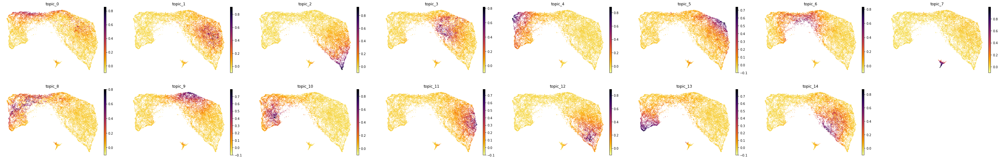

In [297]:
sc.pl.umap(atac_data, color = atac_model.topic_cols, **mira.pref.topic_umap(color_map = 'inferno_r'), vmin = -0.1)

In [92]:
rna_data, atac_data = mira.utils.make_joint_representation(rna_data, atac_data)

INFO:mira.adata_interface.utils:17738 out of 20564 cells shared between datasets (86%).
INFO:mira.adata_interface.utils:Key added to obsm: X_joint_umap_features


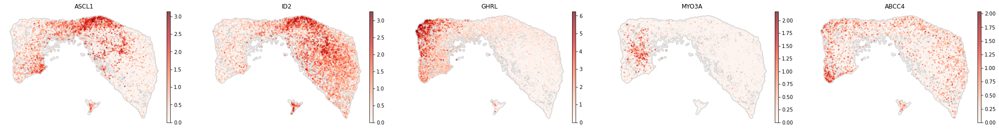

In [93]:
rna_data.obsm['X_atac_umap'] = atac_data.obsm['X_umap']

sc.pl.embedding(rna_data, basis='X_atac_umap', color = ['ASCL1','ID2','GHRL','MYO3A','ABCC4'], **mira.pref.raw_umap())

rna_data.obs = rna_data.obs.drop(columns = rna_data.obs.columns[rna_data.obs.columns.str.endswith('_atac')])

In [94]:
rna_data.obs = rna_data.obs.join(atac_data.obs, rsuffix='_atac', how = 'left')

sc.pl.umap(rna_data, color = [x + '_atac' for x in atac_model.topic_cols], **mira.pref.topic_umap(color_map='viridis_r'), vmin = -0.1)

INFO:mira.adata_interface.topic_model:Fetching key X_topic_compositions from obsm
INFO:mira.adata_interface.core:Added key to obsm: X_umap_features
INFO:mira.adata_interface.topic_model:Added key to uns: topic_dendogram
INFO:mira.adata_interface.topic_model:Fetching key X_topic_compositions from obsm
INFO:mira.adata_interface.core:Added key to obsm: X_umap_features
INFO:mira.adata_interface.topic_model:Added key to uns: topic_dendogram
INFO:mira.adata_interface.utils:17738 out of 17738 cells shared between datasets (100%).
INFO:mira.adata_interface.utils:Key added to obsm: X_joint_umap_features


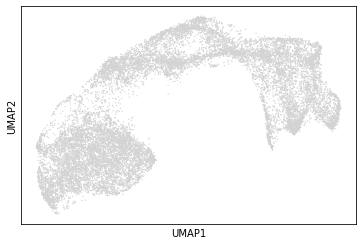

In [95]:
atac_model.get_hierarchical_umap_features(atac_data, box_cox = 0.6)
rna_model.get_hierarchical_umap_features(rna_data, box_cox = 0.6)
rna_data, atac_data = mira.utils.make_joint_representation(rna_data, atac_data)

sc.pp.neighbors(rna_data, use_rep='X_joint_umap_features', metric = 'manhattan')
sc.tl.umap(rna_data, min_dist = 0.1, negative_sample_rate = 1)

sc.pl.umap(rna_data)

<AxesSubplot:xlabel='UMAP1', ylabel='UMAP2'>

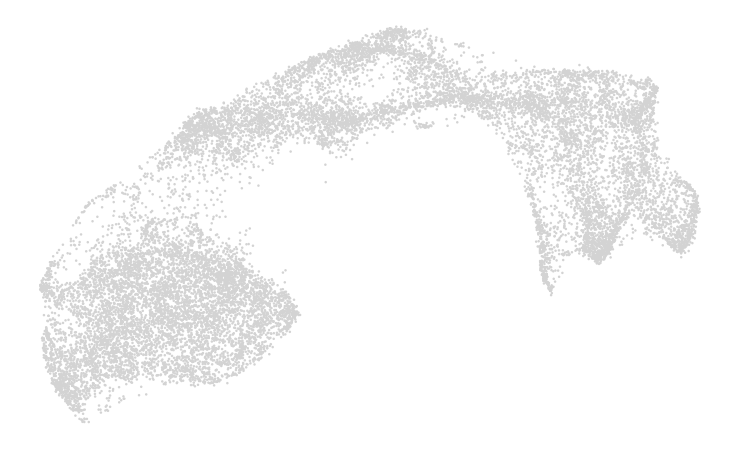

In [96]:
fig, ax = plt.subplots(1,1,figsize=(13,8))
sc.pl.umap(rna_data, ax = ax, show = False, frameon=False, size = 25)

In [97]:
from mira.plots.base import plot_umap, map_plot

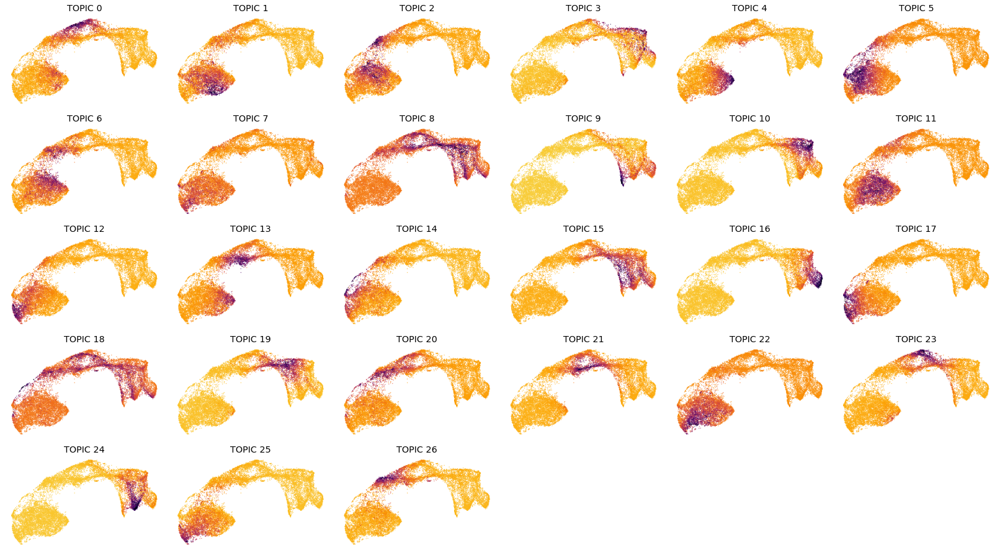

In [98]:
map_plot(
    lambda ax, x : plot_umap(rna_data.obsm['X_umap'], rna_data.obs_vector(x), palette='inferno_r', 
                             vmin = -0.1, add_legend=False, add_outline=False, ax = ax, 
                             size = 0.1, title = x.upper().replace('_',' ')),
    [[x] for x in rna_model.topic_cols],
    plots_per_row=6, height=2.5, aspect=1.5
)
plt.show()

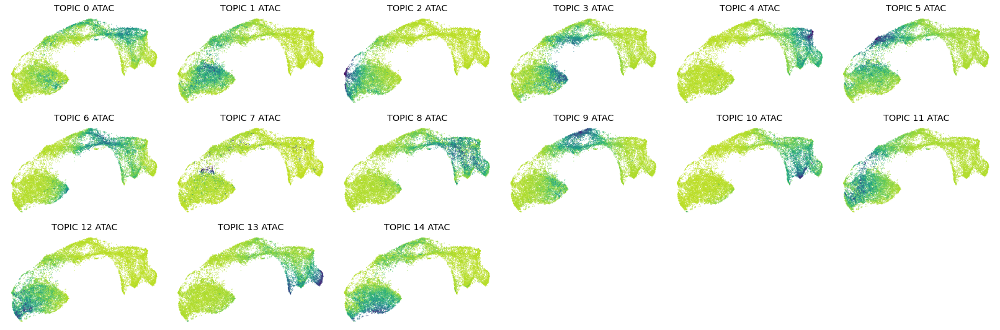

In [99]:
map_plot(
    lambda ax, x : plot_umap(rna_data.obsm['X_umap'], rna_data.obs_vector(x), palette='viridis_r',
                             vmin = -0.1, add_legend=False, add_outline=False, ax = ax, 
                             size = 0.1, title = x.upper().replace('_',' ')),
    [[x + '_atac'] for x in atac_model.topic_cols],
    plots_per_row=6, height=2.5, aspect=1.5
)
plt.show()

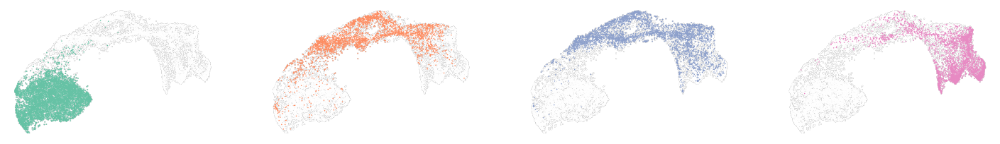

In [100]:
fig, ax = plt.subplots(1,4, figsize=(25,3.5))
for i, t in enumerate(map(str, [1,3,5,6])):
    sc.pl.umap(rna_data, na_color = 'white', ax = ax[i], show = False, add_outline=True, outline_width=(0.1,0), outline_color=('grey','white'), size = 10,
              frameon=False)
    sc.pl.umap(rna_data[rna_data.obs.time == 'PS' + t], na_color = sns.color_palette('Set2')[i], ax = ax[i], show = False, size = 10, frameon=False)

sc.pl.umap(rna_data, color = rna_model.get_top_genes(24, 16), **mira.pref.raw_umap())

rna_data.write_h5ad('data/preprocessing/2022-01-07_joint_representation/rna_data.h5ad')
atac_data.write_h5ad('data/preprocessing/2022-01-07_joint_representation/atac_data.h5ad')

In [2]:
mira.tl.get_motif_hits_in_peaks(atac_data, genome_fasta='/liulab/alynch/projects/atac_bias/hg38.fa')

INFO:mira.tools.motif_scan:Getting peak sequences ...
284863it [00:05, 49163.28it/s]
INFO:mira.tools.motif_scan:Scanning peaks for motif hits with p >= 0.0001 ...
INFO:mira.tools.motif_scan:Building motif background models ...
INFO:mira.tools.motif_scan:Starting scan ...
INFO:mira.tools.motif_scan:Found 1000000 motif hits ...
INFO:mira.tools.motif_scan:Found 2000000 motif hits ...
INFO:mira.tools.motif_scan:Found 3000000 motif hits ...
INFO:mira.tools.motif_scan:Found 4000000 motif hits ...
INFO:mira.tools.motif_scan:Found 5000000 motif hits ...
INFO:mira.tools.motif_scan:Found 6000000 motif hits ...
INFO:mira.tools.motif_scan:Found 7000000 motif hits ...
INFO:mira.tools.motif_scan:Found 8000000 motif hits ...
INFO:mira.tools.motif_scan:Found 9000000 motif hits ...
INFO:mira.tools.motif_scan:Found 10000000 motif hits ...
INFO:mira.tools.motif_scan:Found 11000000 motif hits ...
INFO:mira.tools.motif_scan:Found 12000000 motif hits ...
INFO:mira.tools.motif_scan:Found 13000000 motif hits 

In [3]:
mira.utils.subset_factors(atac_data, use_factors=rna_data.var_names[rna_data.var.n_cells_by_counts > 30])

INFO:mira.adata_interface.utils:Found 602 factors in expression data.


In [201]:
for i in range(atac_model.num_topics):
    atac_model.get_enriched_TFs(atac_data, topic_num=i, top_quantile=0.1)

Finding enrichments: 100%|█████████████████████████████████████████████████████████████████████████████████████████| 602/602 [00:05<00:00, 101.56it/s]


In [144]:
atac_model.save('data/preprocessing/2022-01-11_joint_representation/atac_model.pth')
rna_model.save('data/preprocessing/2022-01-11_joint_representation/rna_model.pth')

atac_data.write_h5ad('data/preprocessing/2022-01-11_joint_representation/atac_data.h5ad')
rna_data.write_h5ad('data/preprocessing/2022-01-11_joint_representation/rna_data.h5ad')

In [ ]:
motif_scores = atac_model.get_motif_scores(atac_data)
motif_scores.obsm['X_umap'] = rna_data.obsm['X_umap']
motif_scores.var=motif_scores.var.set_index('parsed_name')
motif_scores.var_names_make_unique()

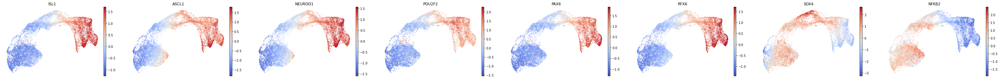

In [234]:
sc.pl.umap(motif_scores, color = ['ISL1','ASCL1','NEUROD1',
                                  'POU2F2','PAX6','RFX6','SOX4','NFKB2'], 
           ncols=8, frameon=False, color_map='coolwarm', layer=None)

In [165]:
motif_scores.write_h5ad('data/preprocessing/2022-01-11_joint_representation/motif_scores.h5ad')

In [210]:
plot_args = dict(
    hue = dict(zip(rna_data.var_names, rna_data.var.dispersions)), 
    palette = 'Greys', 
    legend_label='Dispersion')

analysis_args = dict(
    figsize = (7,7), fontsize=12,
)

show_args = dict(
    figsize=(5,5), fontsize=15,
)

<AxesSubplot:xlabel='Topic 9 Enrichments', ylabel='Todule 3 Enrichments'>

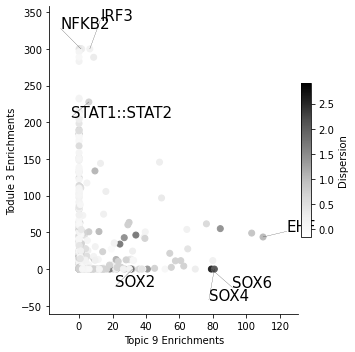

In [202]:
atac_model.plot_compare_topic_enrichments(9, 3, pval_threshold=(1e-50,1e-100), label_closeness=4,
                                         **show_args, **plot_args,
                                          label_factors = ['IRF3','STAT1::STAT2','SOX4','SOX6','NFKB2','EHF','SOX2'])
#plt.savefig('data/analysis/2022-01-11_immune_vs_hippo_ATAC_enrichments.svg')

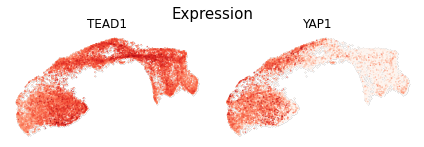

In [264]:
fig, ax = map_plot(lambda ax, gene : plot_umap(rna_data.obsm["X_umap"], rna_data.obs_vector(gene, layer = 'normalized'), palette='Reds',
                                    add_legend=False, ax = ax, add_outline=True, size = 0.1, title = gene, vmin = -0.1,
                                    outline_width=(2,0), outline_color='grey'),
        [[gene] for gene in ['TEAD1','YAP1']], height = 2, plots_per_row = 2, aspect=1.5,vertical=True)
fig.suptitle("Expression", size = 15, y = 1)
plt.show()

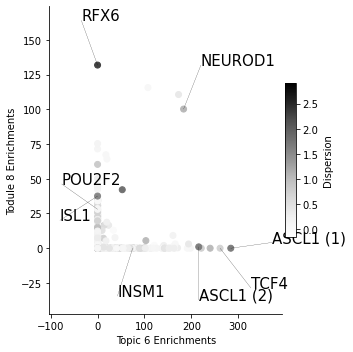

In [255]:
atac_model.plot_compare_topic_enrichments(6, 8, pval_threshold=(1e-100,1e-30), label_closeness=2,
                                         figsize=(5,5), fontsize=15, **plot_args,
                                         label_factors = ['ASCL1','TCF4','NEUROD1','ISL1','RFX6','POU2F2','INSM1'])
plt.savefig('data/analysis/2022-01-11_ascl1_vs_progenitors_atac_enrichments.svg')

<AxesSubplot:xlabel='Topic 8 Enrichments', ylabel='Todule 0 Enrichments'>

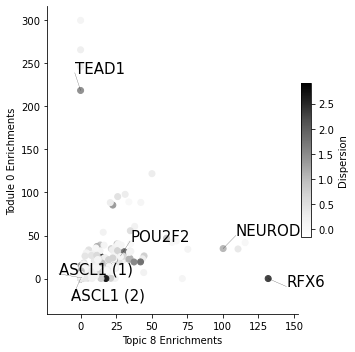

In [235]:
atac_model.plot_compare_topic_enrichments(8,0, pval_threshold=(1e-50,1e-50), label_closeness=5,
                                         figsize=(5,5), fontsize=15, **plot_args,
                                         label_factors = ['TEAD1','NEUROD1','RFX6','ASCL1','POU2F2'])
#plt.savefig('data/analysis/2022-01-11_tead_vs_neurod1_atac_topic_enrichments.svg')

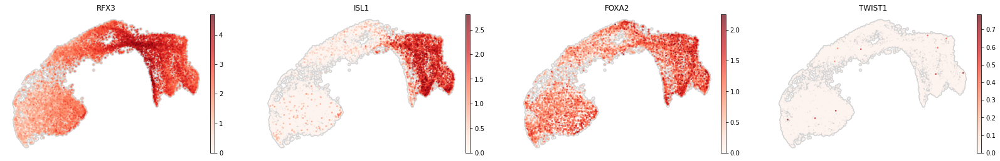

In [254]:
sc.pl.umap(rna_data, color = ['RFX3','ISL1','FOXA2','TWIST1'], **mira.pref.raw_umap())

<AxesSubplot:xlabel='Topic 13 Enrichments', ylabel='Todule 8 Enrichments'>

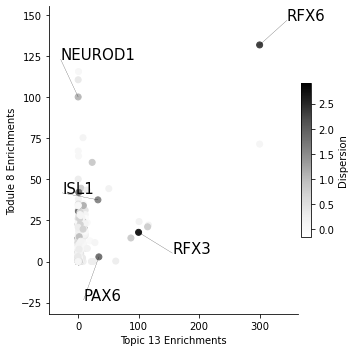

In [240]:
atac_model.plot_compare_topic_enrichments(13,8, pval_threshold=(1e-25,1e-25), label_closeness=3,
                                         figsize=(5,5), fontsize=15, **plot_args,
                                         label_factors = ['RFX3','ISL1','PAX6','NEUROD1','RFX6'])
#plt.savefig('data/analysis/2022-01-11_pax6_vs_ghrl_atac_topic_enrichments.svg')

In [258]:
pd.DataFrame(atac_model.get_enrichments(3)).set_index('parsed_name').loc['INSM1'].pval

2.3607850749493798e-125

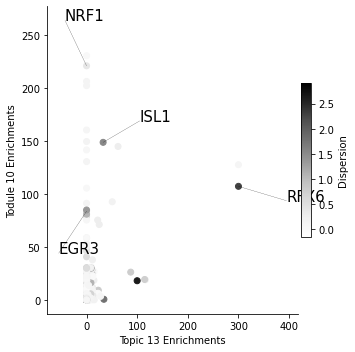

In [243]:
atac_model.plot_compare_topic_enrichments(13,10, pval_threshold=(1e-25,1e-25), label_closeness=2,
                                         figsize=(5,5), fontsize=15, **plot_args,
                                         label_factors = ['NRF1','ISL1','RFX6','EGR3'])
plt.savefig('data/analysis/2022-01-11_pax6_vs_myo3a_atac_enrichments.svg')

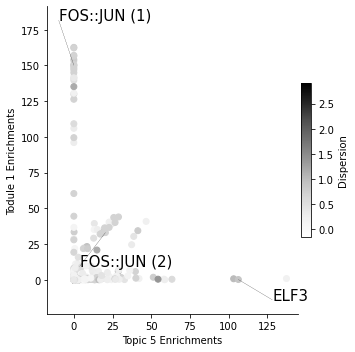

In [52]:
atac_model.plot_compare_topic_enrichments(5,1, pval_threshold=(1e-25,1e-25), label_closeness=3,
                                         **show_args, **plot_args,
                                         label_factors = ['ELF3','FOS::JUN'])
plt.savefig('data/analysis/2022-01-11_pre_day23_branch_vs_day0_atac_enrichments.svg')

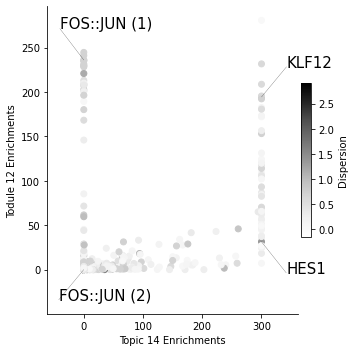

In [55]:
atac_model.plot_compare_topic_enrichments(14,12, pval_threshold=(1e-25,1e-25), label_closeness=3,
                                         figsize=(5,5), fontsize=15, **plot_args,
                                         label_factors = ['HES1','KLF12','FOS::JUN'])
plt.savefig('data/analysis/2022-01-11_day0_left_vs_day0_right_atac_enrichments.svg')

enrich = pd.DataFrame(atac_model.get_enrichments(1))

enrich['topic_9'] = enrich.parsed_name.isin(rna_model.get_top_genes(9, 500))

enrich[enrich.topic_9].sort_values("pval")

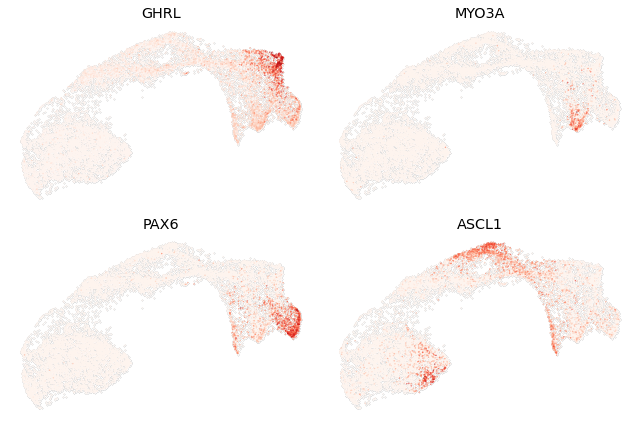

In [118]:
map_plot(lambda ax, gene : plot_umap(rna_data.obsm["X_umap"], rna_data.obs_vector(gene, layer = 'normalized'), palette='Reds',
                                    add_legend=False, ax = ax, add_outline=True, size = 0.1, title = gene, vmin = -0.1,
                                    outline_width=(2,0), outline_color='grey'),
        [[gene] for gene in ['GHRL','PAX6','MYO3A','ASCL1']], height = 3, plots_per_row = 2, aspect=1.5,vertical=True)
plt.show()

## Pseudotime inference

In [105]:
sc.tl.diffmap(rna_data)
mira.time.normalize_diffmap(rna_data,rescale=True)

INFO:root:Added key to obsm: X_diffmap, normalized diffmap with 14 components.
INFO:root:Added key to uns: eigen_gap


Recommending 2 diffusion map components.


/liulab/alynch/projects/multiomics/endocrine/MIRA/mira/plots/eigengap_plot.py:52: UserWarning:

color is redundantly defined by the 'color' keyword argument and the fmt string "--bo" (-> color='b'). The keyword argument will take precedence.



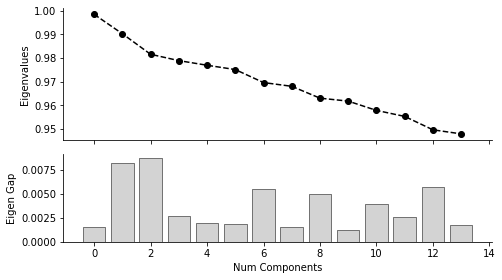

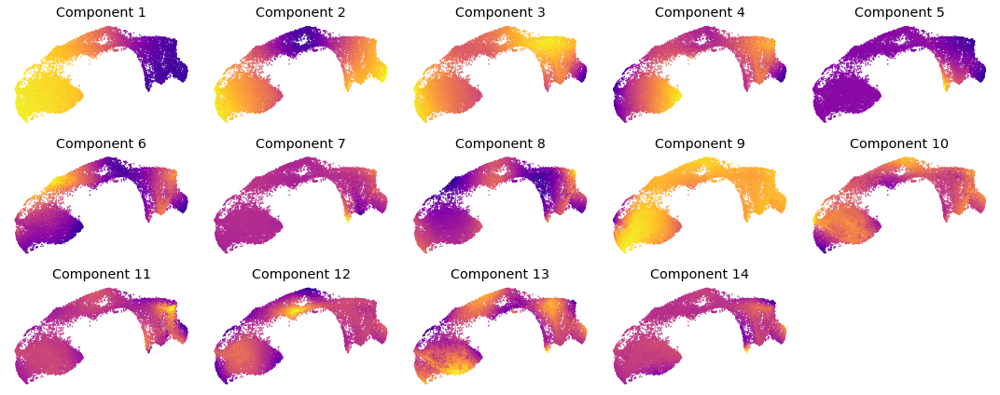

In [106]:
mira.pl.plot_eigengap(rna_data)
plt.show()

In [107]:
sc.pp.neighbors(rna_data, use_rep='X_diffmap', key_added='X_diffmap', n_pcs = 6)
mira.time.get_connected_components(rna_data)

INFO:mira.pseudotime.pseudotime:Found 1 components of KNN graph.
INFO:mira.adata_interface.core:Added cols to obs: mira_connected_components


In [110]:
start_cell = rna_data.obsm['X_diffmap'][:,0].argmax()

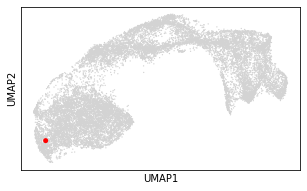

In [111]:
fig, ax = plt.subplots(1,1,figsize=(5,3))
sc.pl.umap(rna_data, ax = ax, show = False, na_color = 'lightgrey')
sc.pl.umap(rna_data[start_cell], ax = ax, show = False, na_color = 'Red', size = 100)
plt.show()

In [112]:
mira.time.get_transport_map(rna_data, start_cell = rna_data.obs_names[start_cell])

INFO:mira.pseudotime.pseudotime:Calculating inter-cell distances ...
INFO:root:Using 1 core. Speed this up by allocating more n_jobs.
Calculating pseudotime:   4%|███▎                                                                              | 2647/66175 [00:01<00:31, 2023.61it/s]
INFO:mira.pseudotime.pseudotime:Calculating transport map ...
/liulab/alynch/projects/multiomics/endocrine/MIRA/mira/pseudotime/pseudotime.py:301: RuntimeWarning:

divide by zero encountered in true_divide

INFO:mira.adata_interface.pseudotime:Added key to obs: mira_pseudotime
INFO:mira.adata_interface.pseudotime:Added key to obsp: transport_map
INFO:mira.adata_interface.pseudotime:Added key to uns: start_cell


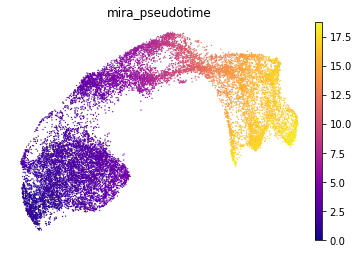

In [113]:
sc.pl.umap(rna_data, color = 'mira_pseudotime', color_map='plasma',
           frameon = False)

In [124]:
terminal_cells = mira.time.find_terminal_cells(rna_data)

INFO:mira.pseudotime.pseudotime:Found 5 terminal states from stationary distribution.


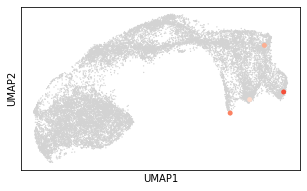

In [128]:
terminal_cells = ['TCAAGCTAGGTAAGCA-PS5', 'GCGTTTCTCCTTTACG-PS6',
       'TCCTTCAAGGGCCACT-PS6', 'GACTATTCAATATGGA-PS6']

fig, ax = plt.subplots(1,1,figsize=(5,3))
sc.pl.umap(rna_data, ax = ax, show = False, na_color = 'lightgrey')
for i, terminal_cell in enumerate(terminal_cells):
    sc.pl.umap(rna_data[terminal_cell], ax = ax, show = False, na_color = sns.color_palette('Reds')[i], size = 100)
plt.show()

In [129]:
terminal_states = dict(zip(
    ['MYO3A','GHRL','ASCL1','PAX6'], terminal_cells
))

In [130]:
mira.time.get_branch_probabilities(rna_data, terminal_cells=terminal_states)

INFO:mira.pseudotime.pseudotime:Simulating random walks ...
/liulab/alynch/projects/cuda/lib/python3.7/site-packages/scipy/stats/_entropy.py:72: RuntimeWarning:

invalid value encountered in true_divide

INFO:mira.adata_interface.pseudotime:Added key to obsm: branch_probs
INFO:mira.adata_interface.pseudotime:Added key to uns: lineage_names
INFO:mira.adata_interface.core:Added cols to obs: MYO3A_prob
INFO:mira.adata_interface.core:Added cols to obs: GHRL_prob
INFO:mira.adata_interface.core:Added cols to obs: ASCL1_prob
INFO:mira.adata_interface.core:Added cols to obs: PAX6_prob
INFO:mira.adata_interface.core:Added cols to obs: differentiation_entropy


INFO:mira.adata_interface.pseudotime:Added key to obs: tree_states
INFO:mira.adata_interface.pseudotime:Added key to uns: tree_state_names
INFO:mira.adata_interface.pseudotime:Added key to uns: connectivities_tree
/liulab/alynch/projects/cuda/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning:

The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.

... storing 'tree_states' as categorical


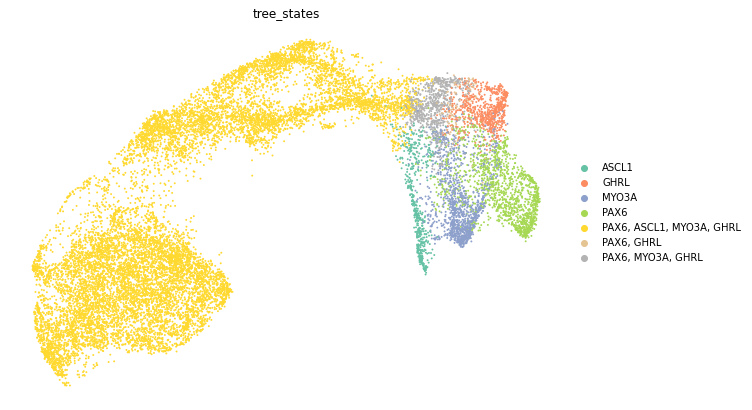

In [88]:
fig, ax = plt.subplots(1,1,figsize=(10,7))
mira.time.get_tree_structure(rna_data, threshold=0.51)
sc.pl.umap(rna_data, color = ['tree_states'], palette = 'Set2', frameon = False, ax = ax, show = False, size = 15)
plt.show()

In [137]:
rna_data.layers['smoothed'] = rna_data.obsp['connectivities'].dot(rna_data.layers['normalized'])

(<Figure size 504x288 with 1 Axes>, <AxesSubplot:>)

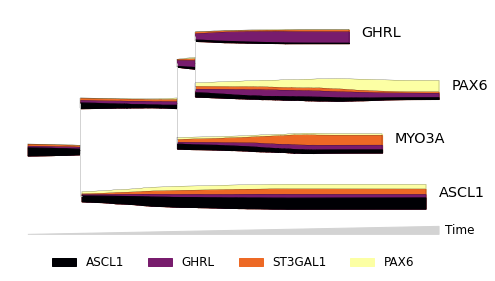

In [90]:
mira.pl.plot_stream(rna_data[rna_data.obs.mira_pseudotime > 13], data = ['ASCL1','ST3GAL1','PAX6','GHRL'], layers='smoothed', 
                    scale_features=True, log_pseudotime=False, window_size=301, clip = 1, palette='inferno', linewidth=0.2,
                   max_bar_height=0.8, figsize=(7,4), min_pseudotime=0)

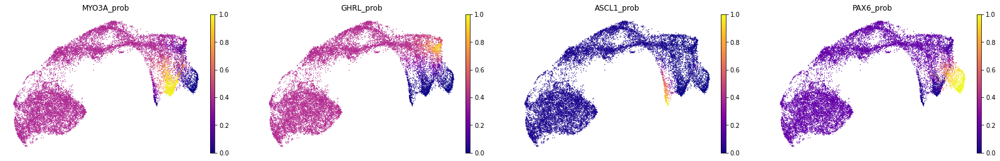

In [139]:
sc.pl.umap(rna_data, color = [x + "_prob" for x in rna_data.uns['lineage_names']], **mira.pref.topic_umap(color_map='plasma'))

In [140]:
rna_data.write_h5ad('data/preprocessing/2022-01-11_joint_representation/rna_data.h5ad')

## Backtracing animation

In [56]:
from functools import partial
from IPython import display
from matplotlib.animation import FuncAnimation, PillowWriter

rna_data = anndata.read_h5ad('data/preprocessing/2022-01-07_joint_representation/rna_data.h5ad')

In [125]:
day6_weight = (rna_data.obs.time == 'PS6').values.astype(int).reshape((1,-1)) * 30 + 1

In [136]:
from mira.pseudotime.pseudotime import prune_edges, make_markov_matrix, get_adaptive_affinity_matrix, get_kernel_width

ka = 3
distance_matrix = rna_data.obsp['X_diffmap_distances']
pseudotime = rna_data.obs.mira_pseudotime.values.max() - rna_data.obs.mira_pseudotime.values

kernel_width = get_kernel_width(ka, distance_matrix)

distance_matrix = prune_edges(kernel_width = kernel_width, 
    pseudotime = pseudotime, distance_matrix = distance_matrix)

affinity_matrix = get_adaptive_affinity_matrix(kernel_width = kernel_width,
    distance_matrix = distance_matrix)#.multiply(day6_weight)

transport_map = make_markov_matrix(affinity_matrix)

In [138]:
lineage = 'MYO3A'

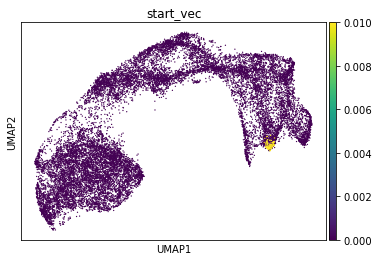

In [139]:
start_vec = ((-rna_data.obs[lineage + '_prob'].values).argsort().argsort() < 100).astype(int)
start_vec = start_vec/start_vec.sum()
rna_data.obs['start_vec'] = start_vec
sc.pl.umap(rna_data, color = 'start_vec')

In [140]:
tmap = transport_map

for i in range(4000):
    start_vec = tmap.T.dot(start_vec.reshape((-1,1)))
    rna_data.obs['start_vec_' + str(i)] = start_vec.copy().reshape(-1)

from mira.plots.base import plot_umap, map_plot, map_colors

def plot_umap(X, hue, palette = 'viridis', projection = '2d', ax = None, figsize= (10,5),
        add_legend = True, hue_order = None, size = 2, title = None, vmin = None, vmax = None, 
        add_outline = False, outline_color = 'lightgrey', outline_width = (0, 0.5),
        **plot_kwargs):
    
    plot_order = hue.argsort()

    if ax is None:
        fig, ax = plt.subplots(1,1,figsize=figsize)

    if isinstance(size, (list, np.ndarray)):
        size = size[plot_order]

    colors = map_colors(ax, hue[plot_order], palette, add_legend=add_legend, hue_order = hue_order, vmin = vmin, vmax = vmax,
            cbar_kwargs = dict(orientation = 'vertical', pad = 0.01, shrink = 0.5, aspect = 15, anchor = (1.05, 0.5)),
            legend_kwargs = dict(loc="center left", markerscale = 4, frameon = False, title_fontsize='x-large', fontsize='large',
                        bbox_to_anchor=(1.05, 0.5)))

    if add_outline:
        assert(isinstance(outline_width, (tuple, list)))
        assert(len(outline_width) == 2)
        assert(outline_width[0] >= 0 and outline_width[1] >= 0)
        
        first_ring_size = size + size*outline_width[0]
        second_ring_size = first_ring_size + size*outline_width[1]

        ax.scatter(X[plot_order,0], X[plot_order,1], color = outline_color, s= second_ring_size, **plot_kwargs)
        ax.scatter(X[plot_order,0], X[plot_order,1], color = 'white', s= first_ring_size, **plot_kwargs)

    view = ax.scatter(X[plot_order,0], X[plot_order,1], c = colors, s= size, **plot_kwargs)
    ax.axis('off')

    if not title is None:
        ax.set_title(str(title), fontdict= dict(fontsize = 'x-large'))

    return ax, view, plot_order

timepoint_probs = np.log(rna_data.obs[['start_vec_' + str(i) for i in range(4000)]].values + 1e-4).T

## PLOT ##
fig, ax = plt.subplots(1,1,figsize=(10,6))

_, view, original_plot_order = plot_umap(rna_data.obsm["X_umap"],  timepoint_probs[0], palette = 'Blues', add_outline=True, 
              add_legend=False, ax = ax, size = 1, outline_width=(0,12))

def animate(frame_num,*, view, timepoint_probs, original_ordering):
    
    probs = timepoint_probs[frame_num]
    vmax = np.quantile(probs, 0.99)
    
    order = probs.argsort()
    
    probs = probs[order]
    view.set_offsets(rna_data.obsm["X_umap"][order])
    
    color = map_colors(None, probs, vmax = vmax, add_legend=False, palette = 'Blues')
    view.set_color(color)

    return view

anim = FuncAnimation(fig, partial(animate, view = view, timepoint_probs = timepoint_probs[1::5], 
                                  original_ordering = original_plot_order), frames=200, interval=50)
#animate(175, view = view, timepoint_probs=timepoint_probs, original_ordering = original_plot_order)
#plt.show()
'''video = anim.to_html5_video()
html = display.HTML(video)
display.display(html)
plt.close()    '''
plt.close()

writergif = PillowWriter(fps=30) 
anim.save('data/analysis/{}_lineage_backtrace.gif'.format(lineage), writer=writergif)

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.PillowWriter'>


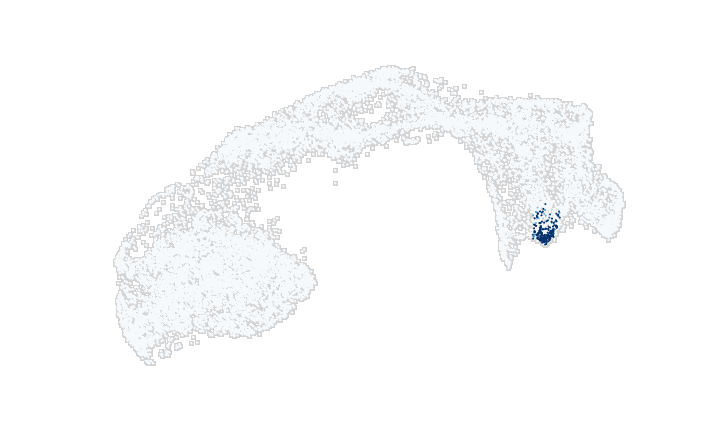

In [141]:
display.Image('data/analysis/{}_lineage_backtrace.gif'.format('MYO3A'))

rna_data.obs['nacol'] = np.nan

rna_data.obs.time = rna_data.obs.time.astype(str)
fig, ax = plt.subplots(1,3,figsize=(20,5))
for i, t in enumerate(rna_data.obs.time.unique()[1:]):
    mira.pl.plot_stream(rna_data[rna_data.obs.time == t], style = 'swarm', data= 'nacol', color = 'black',
                       max_swarm_density=200, log_pseudotime=False, size = 1.5, ax = ax[i], show_legend= False,
                       title = t)

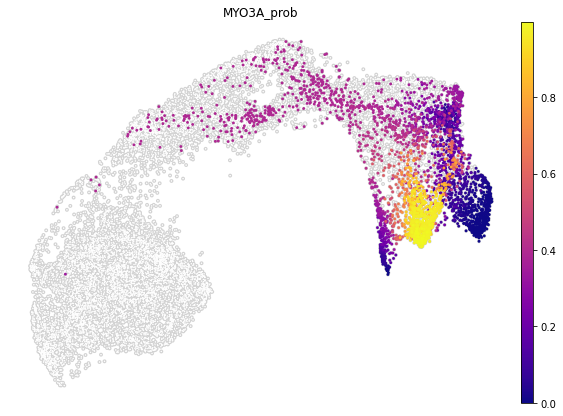

In [135]:
fig, ax = plt.subplots(1,1,figsize=(10,7))
sc.pl.umap(rna_data, na_color = 'white', frameon = False, ax = ax, show = False, add_outline = True, 
          outline_color = ('lightgrey','white'), outline_width=(1.,0))
sc.pl.umap(rna_data[rna_data.obs.time == 'PS6'], color = 'MYO3A_prob',
           na_color = sns.color_palette('Set2')[3], frameon = False, ax = ax, show = False, color_map = 'plasma')
plt.show()

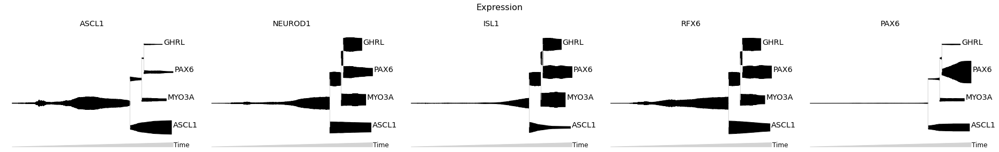

In [268]:
mira.pl.plot_stream(rna_data, data = ['NEUROD1','ASCL1','ISL1','RFX6','PAX6'], style = 'stream', 
                    layers = 'smoothed', split = True, max_bar_height=0.8,                    
                    clip = 3, log_pseudotime=False, window_size=301, plots_per_row=5,
                   scale_features=True, ax = ax, title = 'Expression')
plt.savefig('data/analysis/2022-01-11_TF_expression_split_stream.svg')

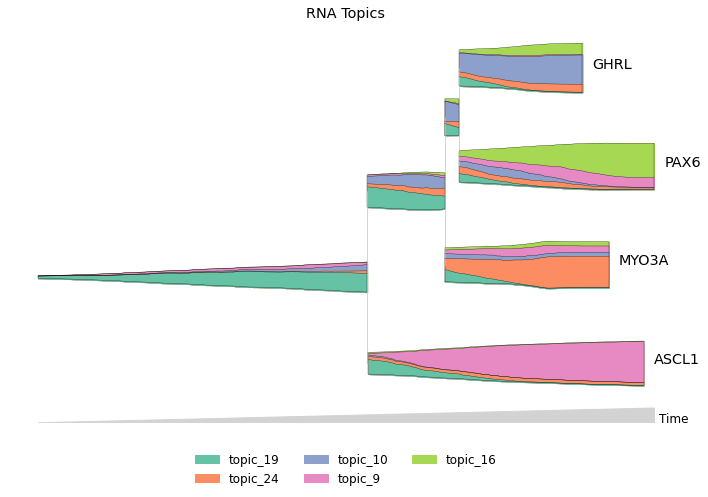

In [270]:
mira.pl.plot_stream(rna_data[rna_data.obs.mira_pseudotime > 8], data = ['topic_' + str(i) for i in [19,9,24,10,16]], 
                    style = 'stream', palette=sns.color_palette('Set2'),figsize=(10,7),
                   hide_feature_threshold=0.03, log_pseudotime=False, window_size=301, legend_cols=3, linewidth=0.3, title = 'RNA Topics')
plt.savefig('data/analysis/2022-01-11_rna_topic_streams.svg')

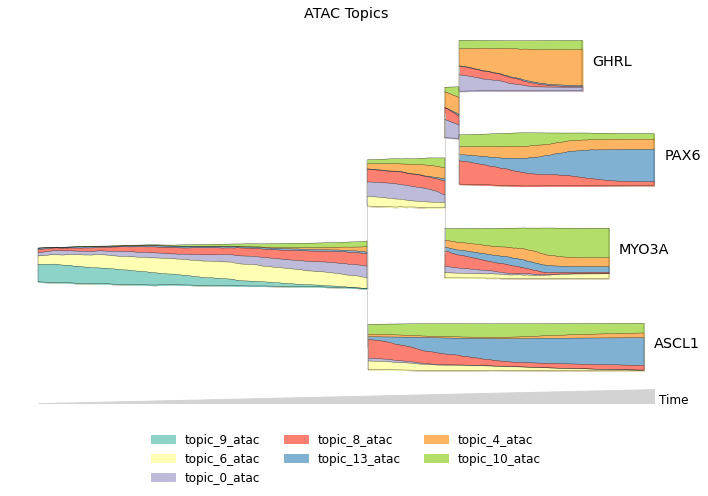

In [260]:
mira.pl.plot_stream(rna_data[rna_data.obs.mira_pseudotime > 8], data = ['topic_' + str(x) + '_atac' for x in [0,4,6,8,9,10,13]], 
                    style = 'stream', palette='Set3', figsize=(10,7),
                   hide_feature_threshold=0.05, log_pseudotime=False,
                    window_size=301, legend_cols=3, linewidth=0.3, title = 'ATAC Topics')
plt.savefig('data/analysis/2022-01-11_atac_topic_streams.svg')

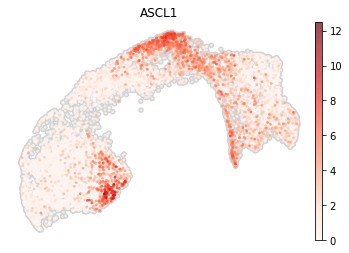

In [142]:
sc.pl.umap(rna_data, color = 'ASCL1', layer = 'normalized', **mira.pref.raw_umap())

## ChIP-seq analysis

In [716]:
!lisa install hg38 regions /liulab/alynch/lisa_data/2021_01_25_lisa_datasets/hg38_100_2.0.h5

In [718]:
mira.tl.get_ChIP_hits_in_peaks(atac_data, species= 'hg38')

Loading gene info ...
Validating user-provided regions ...
INFO:mira.adata_interface.regulators:Added key to varm: chip_hits
INFO:mira.adata_interface.regulators:Added key to uns: chip


In [719]:
atac_data.write_h5ad('data/preprocessing/2022-01-11_joint_representation/atac_data.h5ad')

In [720]:
mira.utils.subset_factors(atac_data, use_factors=rna_data.var_names[rna_data.var.n_cells_by_counts > 30], factor_type='chip')

INFO:mira.adata_interface.utils:Found 6350 factors in expression data.


In [723]:
for i in range(atac_model.num_topics):
    atac_model.get_enriched_TFs(atac_data, topic_num=i, top_quantile=0.1, factor_type = 'chip')

Finding enrichments: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6350/6350 [00:26<00:00, 235.80it/s]


In [725]:
atac_model.save('data/preprocessing/2022-01-11_joint_representation/atac_model.pth')

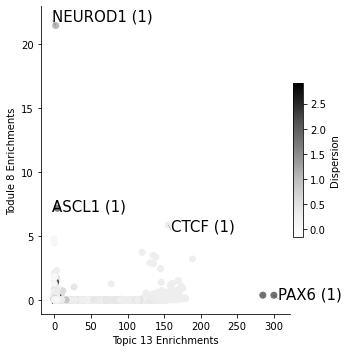

In [218]:
atac_model.plot_compare_topic_enrichments(13,8, pval_threshold=(1e-100,1e-5), label_closeness=2, max_label_repeats=1,
                                         factor_type = 'chip',**plot_args,
                                         label_factors = ['PAX6', 'NEUROD1','ASCL1','CTCF'], **show_args)
plt.savefig('data/analysis/chip_enrichments/2022-01-11_pax6_vs_ghrl_atac_topic_enrichments.svg')

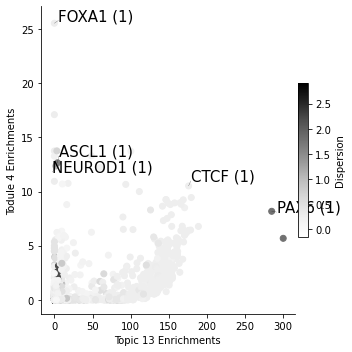

In [238]:
atac_model.plot_compare_topic_enrichments(13,4, pval_threshold=(1e-100,1e-5), label_closeness=2, max_label_repeats=1,
                                         factor_type = 'chip',**plot_args,
                                         label_factors = ['PAX6', 'NEUROD1','ASCL1','CTCF','FOXA1'], **show_args)
plt.savefig('data/analysis/chip_enrichments/2022-01-11_13_vs_4_atac_topic_enrichments.svg')

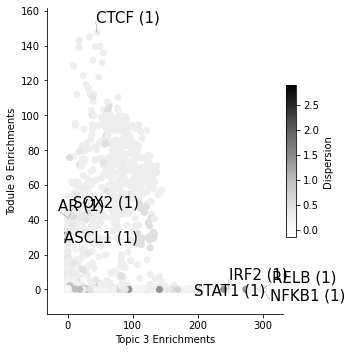

In [239]:
atac_model.plot_compare_topic_enrichments(3,9, pval_threshold=(1e-150,1e-25), label_closeness=1, max_label_repeats=1,
                                         **plot_args, factor_type = 'chip', **show_args,
                                         label_factors = ['ASCL1','AR','SOX2','CTCF','NFKB1','RELB','IRF2','STAT1'])
plt.savefig('data/analysis/chip_enrichments/2022-01-11_9_vs_3_atac_topic_enrichments.svg')

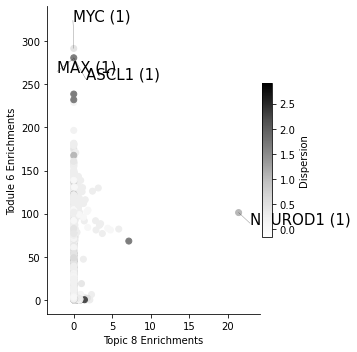

In [246]:
atac_model.plot_compare_topic_enrichments(8,6, pval_threshold=(1e-5,1e-150), label_closeness=1, max_label_repeats=1,
                                         **show_args, **plot_args, factor_type = 'chip',
                                         label_factors = ['MYC','MAX','ASCL1','NEUROD1','NEURODG2'])
plt.savefig('data/analysis/chip_enrichments/2022-01-11_8_vs_6_atac_topic_enrichments.svg')

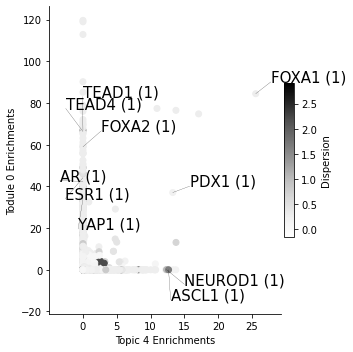

In [260]:
atac_model.plot_compare_topic_enrichments(4,0, pval_threshold=(1e-5,1e-30), label_closeness=0.5, max_label_repeats=1,
                                         **show_args, **plot_args, factor_type = 'chip',
                                         label_factors = ['TEAD1','TEAD4','FOXA2','AR','FOXA1','ESR1','YAP1','NEUROD1','ASCL1','PDX1','ASCL1'])
plt.savefig('data/analysis/chip_enrichments/2022-01-11_4_vs_0_atac_topic_enrichments.svg')

<AxesSubplot:xlabel='Topic 0 Enrichments', ylabel='Todule 13 Enrichments'>

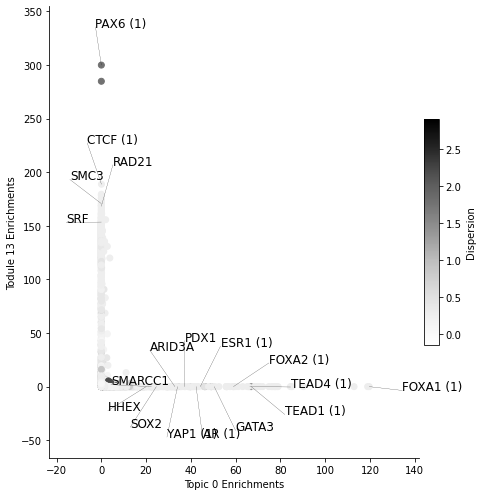

In [763]:
atac_model.plot_compare_topic_enrichments(0, 13, pval_threshold=(1e-20,1e-150), label_closeness=1, max_label_repeats=1,
                                         figsize=(7,7), fontsize=12, **plot_args, factor_type = 'chip',
                                         label_factors = None)
#plt.savefig('data/analysis/2022-01-11_pax6_vs_ghrl_atac_topic_enrichments.svg')

In [758]:
litemodel = mira.rp.LITE_Model.load_dir(expr_model=rna_model, accessibility_model=atac_model,
                                       counts_layer = 'counts', prefix='data/preprocessing/models/2022-01-07_RP_models/')

data/preprocessing/models/2022-01-07_RP_models/cis_AC015923.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC010148.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC016735.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC011997.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC015987.pth
data/preprocessing/models/2022-01-07_RP_models/cis_AC114763.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC147651.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC006460.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC007319.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC005562.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AP001372.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC005104.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC016730.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC104088.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC010642.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC009495.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC006994.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AP001057.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC002066.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AP000462.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC022182.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC005256.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC025171.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AP001042.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC005083.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC010894.pth
data/preprocessing/models/2022-01-07_RP_models/cis_AP002381.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AC007292.pth


data/preprocessing/models/2022-01-07_RP_models/cis_AP000331.pth


# RP Model Analysis

In [23]:
rp_modeled_data = anndata.read_h5ad('data/preprocessing/2022-01-11_joint_representation/rp_modeled_rna_data.h5ad')
rp_layers = [x + '_' + y for x in ['LITE','NITE'] for y in ['logp','prediction']]

In [24]:
assert((rp_modeled_data.obs_names == rna_data.obs_names).all())

for l in rp_layers:
    rna_data.layers[l] = rp_modeled_data.layers[l]

In [25]:
rna_data.varm['motifs-prob_deletion'] = rp_modeled_data.varm['motifs-prob_deletion']
rna_data.uns['motifs'] = rp_modeled_data.uns['motifs']

In [26]:
mira.tl.get_NITE_score_genes(rna_data)
mira.tl.get_NITE_score_cells(rna_data)

INFO:mira.adata_interface.lite_nite:Added keys to var: NITE_score, nonzero_counts
INFO:mira.adata_interface.lite_nite:Added keys to obs: NITE_score, nonzero_counts


In [27]:
mira.tl.get_chromatin_differential(rna_data)

INFO:mira.adata_interface.core:Added layer: chromatin_differential


In [28]:
rna_data.write_h5ad('data/preprocessing/2022-01-11_joint_representation/rna_data.h5ad')

In [21]:
import mira
import anndata
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
mira.utils.wide_view()
from mira.plots.base import map_plot, plot_umap

rna_data = anndata.read_h5ad('data/preprocessing/2022-01-11_joint_representation/rna_data.h5ad')
atac_data = anndata.read_h5ad('data/preprocessing/2022-01-11_joint_representation/atac_data.h5ad')

rna_model = mira.topics.ExpressionTopicModel.load('data/preprocessing/2022-01-11_joint_representation/rna_model.pth')
atac_model = mira.topics.AccessibilityTopicModel.load('data/preprocessing/2022-01-11_joint_representation/atac_model.pth')

INFO:mira.topic_model.base:Moving model to CPU for inference.
INFO:mira.topic_model.base:Moving model to device: cpu
INFO:mira.topic_model.base:Moving model to CPU for inference.
INFO:mira.topic_model.base:Moving model to device: cpu


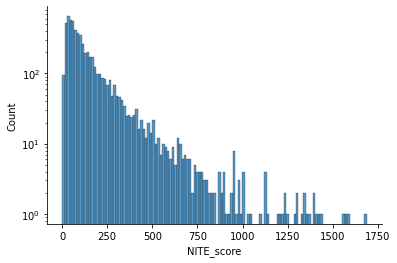

In [18]:
ax = sns.histplot(data = rna_data.var, x='NITE_score')
ax.set(yscale = 'log')
sns.despine()

nite_list = mira.tl.post_genelist(rna_data.var.NITE_score.dropna().sort_values().tail(500).index.values)
lite_list = mira.tl.post_genelist(rna_data.var.NITE_score.dropna().sort_values().head(500).index.values)

nite_enrich = mira.tl.fetch_ontologies(nite_list)
lite_enrich = mira.tl.fetch_ontologies(lite_list)

mira.pl.plot_enrichments(lite_enrich)

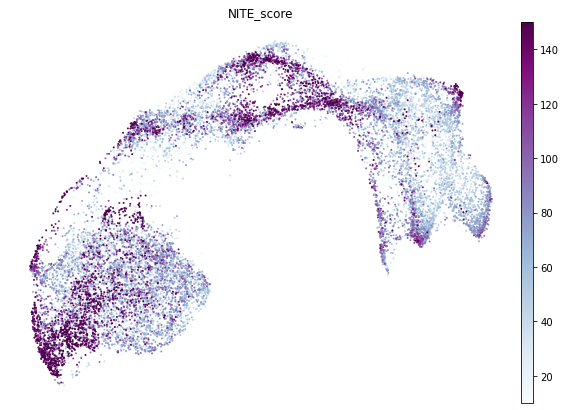

In [19]:
fig, ax = plt.subplots(1,1,figsize=(10,7))
sc.pl.umap(rna_data, color = 'NITE_score', frameon=False, color_map='BuPu', vmin = 10, vmax = 150,
          ax = ax, show = False, size = 15)
plt.savefig('data/analysis/NITE_score_umap.png')

In [20]:
def _range(x):
    return (x.max(0) - x.min(0)).toarray().reshape(-1)

In [21]:
rna_data.var['lite_nite_range'] = _range(rna_data.layers['LITE_prediction'].tocsc())/_range(rna_data.layers['NITE_prediction'].tocsc())

/liulab/alynch/projects/cuda/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning:

divide by zero encountered in true_divide

/liulab/alynch/projects/cuda/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning:

invalid value encountered in true_divide



sc.tl.leiden(rna_data, resolution=0.8)

sc.pl.umap(rna_data, color = 'leiden', legend_loc='on data')

sc.tl.rank_genes_groups(rna_data, groupby = 'leiden', layer = 'chromatin_differential', groups=['5'], reference='10', method='t-test', use_raw = False)

diffchrom = sc.get.rank_genes_groups_df(rna_data, group='5')

diffchrom.set_index('names').loc[genenames].sort_values('logfoldchanges').dropna().tail(10).index.values

from sklearn.cluster import AgglomerativeClustering

rna_data.var = rna_data.var.drop(columns= 'chromdiff_cluster')

genenames = rna_data.var_names[(~np.isnan(rna_data.var.NITE_score)) & (rna_data.var.NITE_score > 250) & (rna_data.var.lite_nite_range > 0.2)]
differentials = rna_data[:, genenames].layers['chromatin_differential'].T.toarray()
#differentials = np.hstack([rna_data[:, genenames].layers['LITE_prediction'].T.toarray(), rna_data[:, genenames].layers['NITE_prediction'].T.toarray()])
clust = AgglomerativeClustering(linkage='ward', n_clusters = 10).fit(differentials/np.linalg.norm(differentials, axis = 1, keepdims=True))

rna_data.var = rna_data.var.join(
    pd.Series(clust.labels_.astype(str), genenames, name = 'chromdiff_cluster'),
    how = 'left'
)

rna_data.var['in_set'] = rna_data.var_names.isin(rna_model.get_top_genes(0, 500))
sns.countplot(data = rna_data.var, x = 'chromdiff_cluster', order = map(str, range(10)),
             hue = 'in_set', )

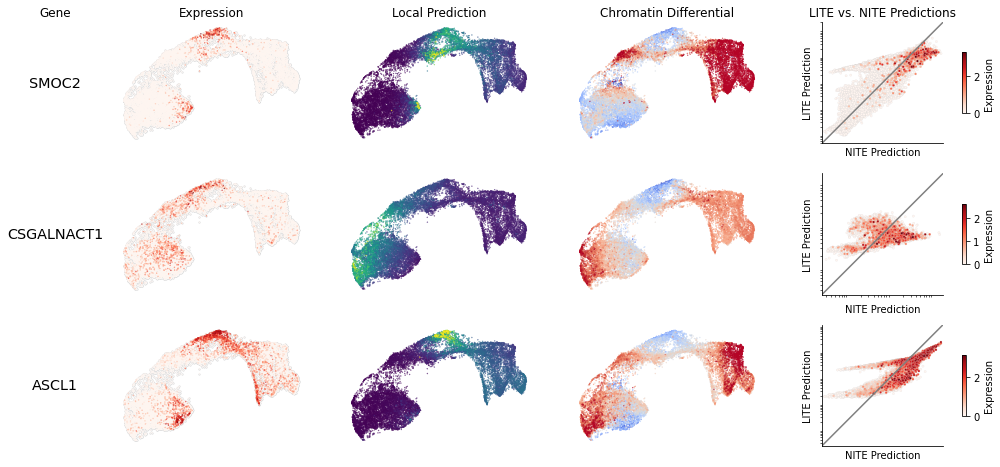

In [24]:
mira.pl.plot_chromatin_differential(rna_data, genes = rna_data.var[rna_data.var_names.isin(rna_model.get_top_genes(0, 300)) & (rna_data.var.lite_nite_range > 0.1)]\
                                    ['NITE_score'].dropna().sort_values().tail(10).index.values[[-4,-2,-1]], 
                                    size = 0.1, height = 2.2, add_legend = False)
plt.show()

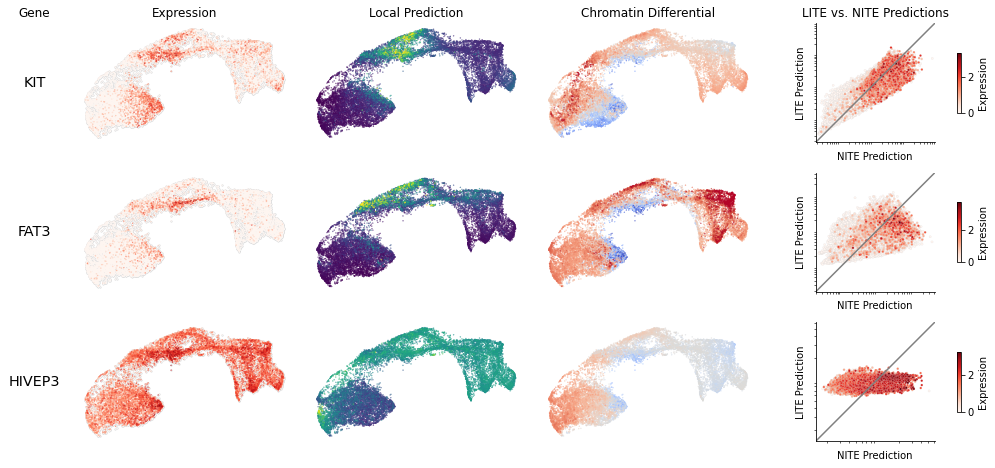

In [26]:
mira.pl.plot_chromatin_differential(rna_data, genes = ['KIT','FAT3','HIVEP3'],
                                    size = 0.1, height = 2.2, add_legend=False)
plt.show()

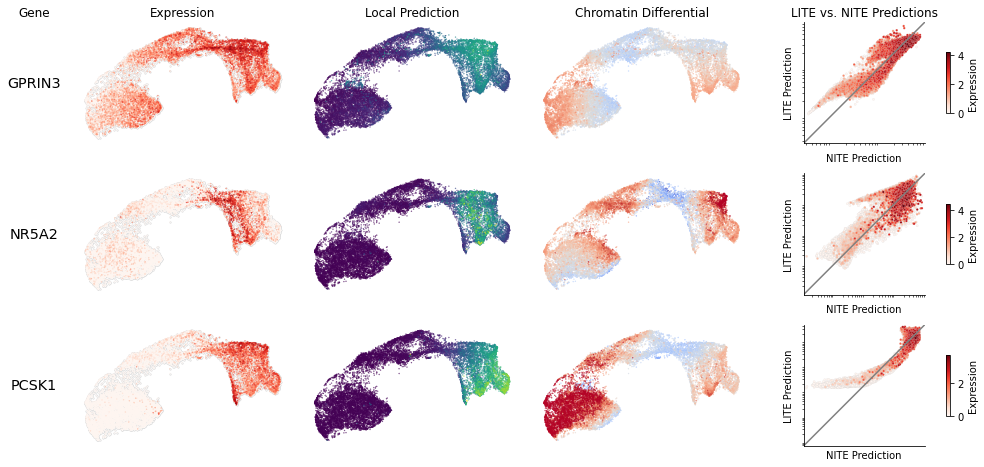

In [28]:
mira.pl.plot_chromatin_differential(rna_data, genes = ['GPRIN3','NR5A2','PCSK1'],
                                    size = 0.1, height = 2.2, add_legend=False)
plt.show()

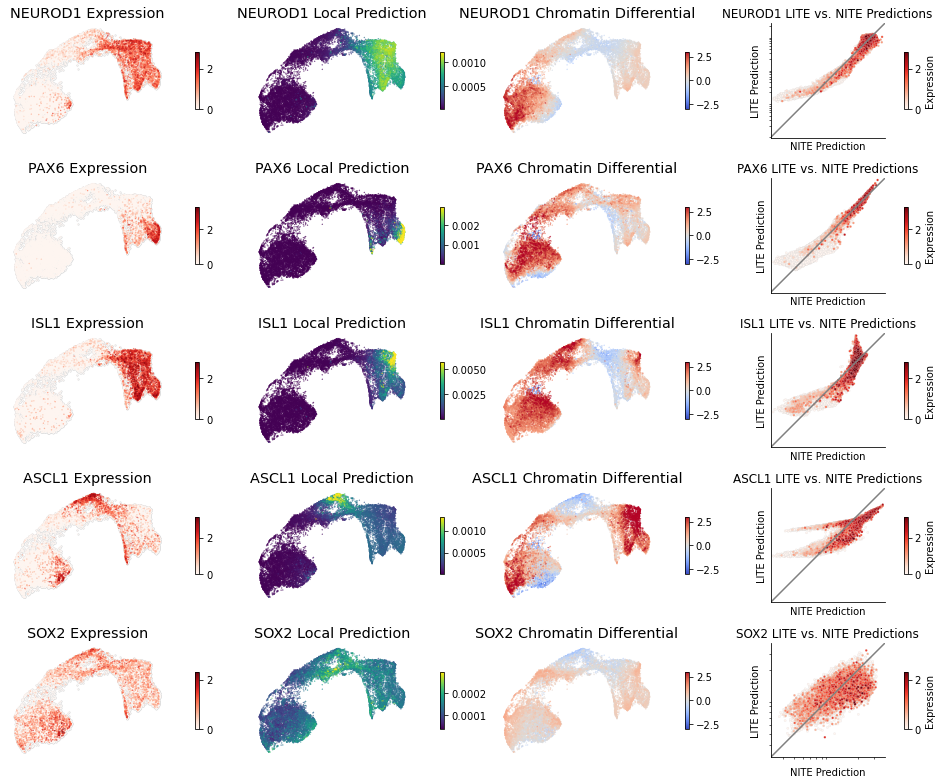

In [698]:
mira.pl.plot_chromatin_differential(rna_data, genes = ['NEUROD1','PAX6','ISL1','ASCL1','SOX2'],
                                    size = 0.1, height = 2.2)
plt.show()

## ISD Analysis

INFO:mira.tools.tf_targeting:Testing with 247 query genes and 5690 background genes, against 602 factors
Testing factors: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 602/602 [00:01<00:00, 301.58it/s]
INFO:mira.tools.tf_targeting:Testing with 230 query genes and 5707 background genes, against 602 factors
Testing factors: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 602/602 [00:01<00:00, 305.94it/s]


<AxesSubplot:xlabel='Set1 Drivers', ylabel='Set2 Drivers'>

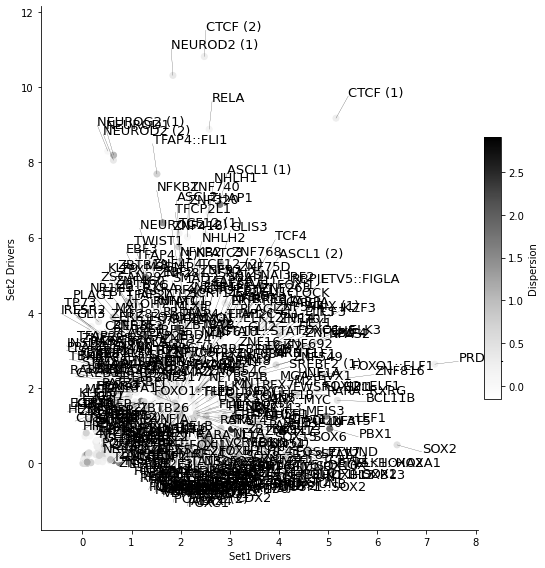

In [690]:
mira.pl.compare_driver_TFs_plot(rna_data, geneset1=rna_data.var[rna_data.var_names.isin(rna_model.get_top_genes(0, 300)) & (rna_data.var.lite_nite_range > 0.3)]\
                                    ['NITE_score'].dropna().sort_values().index.values, 
                                geneset2=rna_data.var[rna_data.var_names.isin(rna_model.get_top_genes(13, 300)) & (rna_data.var.lite_nite_range > 0.3)]\
                                    ['NITE_score'].dropna().sort_values().index.values, **plot_args,
                                background = None, #label_factors = ['SOX2','RELA','IRF3','LEF1'],
                               pval_threshold=(1e-2,1e-2))

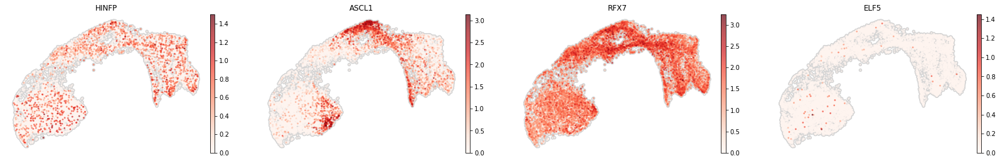

In [551]:
sc.pl.umap(rna_data, color = ['HINFP','ASCL1','RFX7','ELF5'], **mira.pref.raw_umap())

In [353]:
isd_matrix = mira.utils.fetch_ISD_matrix(rna_data)

In [428]:
rna_data.obs = rna_data.obs.drop(columns = rna_data.obs.columns[rna_data.obs.columns.str.startswith('start_vec')])

In [153]:
bg_genes = rna_data.var_names[~np.isnan(rna_data.var.NITE_score)].values

INFO:mira.tools.tf_targeting:Testing with 417 query genes and 5505 background genes, against 602 factors
Testing factors: 100%|█████████████████████████████████████████████████████████████████████████████████████████████| 602/602 [00:01<00:00, 316.43it/s]
INFO:mira.tools.tf_targeting:Testing with 452 query genes and 5470 background genes, against 602 factors
Testing factors: 100%|█████████████████████████████████████████████████████████████████████████████████████████████| 602/602 [00:01<00:00, 322.41it/s]


<AxesSubplot:xlabel='Converged progenitors', ylabel='Later progenitors'>

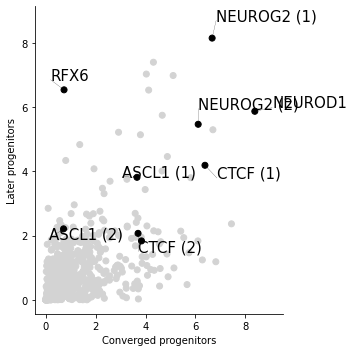

In [284]:
label_factors=['ASCL1','NEUROD1','CTCF','RFX6','NEUROG2']
mira.pl.compare_driver_TFs_plot(rna_data, geneset1=np.intersect1d(bg_genes, rna_model.get_top_genes(19, 500)), 
                                geneset2=np.intersect1d(rna_model.get_top_genes(10, 500), bg_genes),
                                label_closeness = 5, figsize=(5,5), hue = {f : 1 for f in label_factors},
                                background = bg_genes, label_factors = label_factors, #['ASCL1','NEUROD1','CTCF','RELA'],
                                show_legend=False, palette = 'Greys_r', axlabels = ('Converged progenitors', 'Later progenitors'),
                               pval_threshold=(1e-3,1e-3), max_label_repeats=2, fontsize=15)
#plt.savefig('data/analysis/2022-01-11_driver_TF_analysis_convergence_point.svg')

INFO:mira.tools.tf_targeting:Testing with 146 query genes and 4066 background genes, against 602 factors
Testing factors: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 602/602 [00:01<00:00, 402.18it/s]
INFO:mira.tools.tf_targeting:Testing with 120 query genes and 4092 background genes, against 602 factors
Testing factors: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 602/602 [00:01<00:00, 394.70it/s]


<AxesSubplot:xlabel='Set1 Drivers', ylabel='Set2 Drivers'>

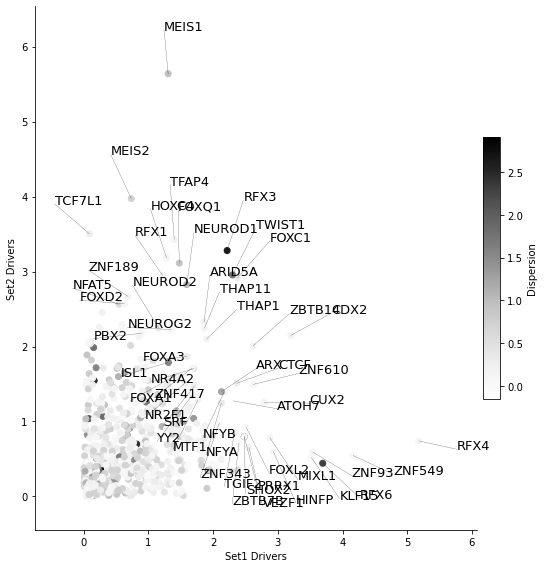

In [407]:
mira.pl.compare_driver_TFs_plot(rna_data, geneset1=np.intersect1d(bg_genes, rna_model.get_top_genes(16, 200)), 
                                geneset2=np.intersect1d(rna_model.get_top_genes(19, 200), bg_genes), **plot_args,
                                background = bg_genes, #label_factors = ['SOX2','RELA','IRF3','LEF1'],
                               pval_threshold=(1e-3,1e-3))

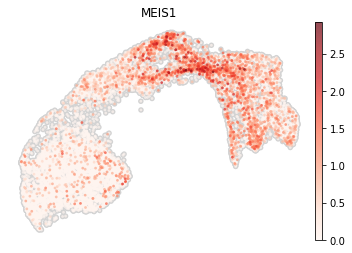

In [405]:
sc.pl.umap(rna_data, color = 'MEIS1', **mira.pref.raw_umap())

## Locus visualization

In [1]:
import mira
import anndata
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
mira.utils.wide_view()
from mira.plots.base import map_plot, plot_umap

rna_data = anndata.read_h5ad('data/preprocessing/2022-01-11_joint_representation/rna_data.h5ad')
atac_data = anndata.read_h5ad('data/preprocessing/2022-01-11_joint_representation/atac_data.h5ad')

rna_model = mira.topics.ExpressionTopicModel.load('data/preprocessing/2022-01-11_joint_representation/rna_model.pth')
atac_model = mira.topics.AccessibilityTopicModel.load('data/preprocessing/2022-01-11_joint_representation/atac_model.pth')

INFO:mira.topic_model.base:Moving model to CPU for inference.
INFO:mira.topic_model.base:Moving model to device: cpu
INFO:mira.topic_model.base:Moving model to CPU for inference.
INFO:mira.topic_model.base:Moving model to device: cpu


In [2]:
import pandas as pd

atac_data.write_h5ad('data/preprocessing/2022-01-11_joint_representation/atac_data.h5ad')

In [207]:
litemodel = mira.rp.LITE_Model(expr_model=rna_model, accessibility_model=atac_model, genes = ['ASCL1','NR5A2','NEUROD1','CNKSR3',
                                                                                              'NEUROG3','SMOC2','PAX6','PAX4','PCSK1'],
                              counts_layer='counts').load('data/preprocessing/models/2022-01-07_RP_models/')

tss_data.chromStart = tss_data.chromStart.astype(int).astype(str)
tss_data.chromEnd = tss_data.chromEnd.astype(int).astype(str)

tss_data['score'] = 0

tss_data[['chrom','chromStart','chromEnd','geneSymbol','score','strand']].sort_values(['chrom','chromStart']).to_csv('data/hg38_tss.bed', sep = '\t', index = None, header = None)

!sort -k1,1 -k2,2n data/hg38_tss.bed > temp && mv temp data/hg38_tss.bed

In [117]:
import numpy as np
from scipy import sparse
from lisa.core.genome_tools import Region
import warnings
import matplotlib.patches as patches
import tqdm

def _residual_transform(X, pi_j_hat, n_i):
    
    assert(isinstance(X, np.ndarray))
    assert(isinstance(pi_j_hat, np.ndarray))
    assert(isinstance(n_i, np.ndarray))
    pi_j_hat = np.squeeze(pi_j_hat)[np.newaxis, :]
    n_i = np.squeeze(n_i)[:, np.newaxis]

    mu_ij_hat = n_i * pi_j_hat

    count_dif = n_i - X
    expected_count_dif = n_i - mu_ij_hat

    with warnings.catch_warnings():
        warnings.simplefilter("ignore")

        r_ij = np.multiply(
            np.sign(X - mu_ij_hat), 
            np.sqrt(
            np.where(X > 0, 2 * np.multiply(X, np.log(X / mu_ij_hat)), 0) + \
            2 * np.multiply(count_dif, np.log(count_dif / expected_count_dif))
            )
        )

    return np.clip(np.nan_to_num(r_ij), -10, 10)

def _get_pi(X):
    return np.array(X.sum(0)).reshape(-1)/X.sum()

def _get_n(X):
    return np.array(X.sum(-1)).reshape(-1)


def _make_regpanel(ax,*, accessibility, chrom, start, end, peaks, time):

    accessibility.data = np.ones_like(accessibility.data)
    n_i = _get_n(accessibility)
    p_i = _get_pi(accessibility)

    interval = Region(chrom, start, end)

    overlapped_peaks = np.array([
        Region(*peak).overlaps(interval)
        for peak in peaks
    ])
    
    order = time.argsort()

    X = accessibility[:, overlapped_peaks].toarray()[order, :]

    residuals = _residual_transform(X, p_i[overlapped_peaks], n_i)

    ax.set(xlim = (start, end), ylim = (0, len(residuals)))
    t_ = iter(tqdm.trange((residuals > 0).sum(), desc = 'Plotting fragments'))

    for alpha, position in zip(residuals.T, peaks[overlapped_peaks]):
        
        start, end = (int(position[1]), int(position[2]))
        min_, max_ = alpha.min(), alpha.max()
        transparency = (alpha - min_)/(max_ - min_)
        
        for j, a in enumerate(alpha):
            if a > 0:
                ax.add_patch(
                    patches.Rectangle((start, j), (end - start), 1, color = 'black', alpha = transparency[j])
                )
                next(t_)

    ax.invert_yaxis()

tss_data.set_index('geneSymbol').loc['NR5A2']

In [6]:
from mira.plots.rp_plots import _plot_rp_models
from pygenometracks.tracks import BedTrack

In [16]:
tss = pd.DataFrame(atac_data.uns['TSS_metadata']).set_index('gene')

In [20]:
tss.loc['NR5A2']

chromosome         chr1
strand                +
txEnd         200175603
txStart       200027613
Name: NR5A2, dtype: object

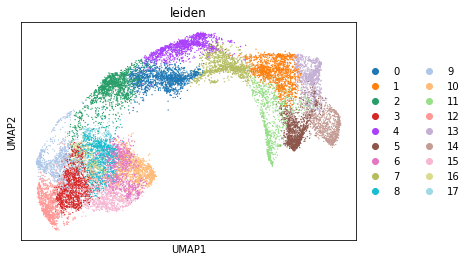

In [27]:
sc.tl.leiden(rna_data)
sc.pl.umap(rna_data, color = 'leiden')

In [272]:
chip_data = mira.utils.fetch_factor_meta(atac_data, factor_type='motifs', mask_factors=False)

print(pd.DataFrame(atac_model.get_enrichments(8, factor_type='motifs')).sort_values('pval'))

chip_data = anndata.AnnData(obs = pd.DataFrame(atac_data.uns['motifs']).set_index('id'), X = atac_data.varm['motifs_hits'].T, var = atac_data.var)

           id         name parsed_name           pval  test_statistic
578  MA1724.1         RFX6        RFX6  1.375093e-132        1.504475
379  MA1642.1      NEUROG2     NEUROG2  2.193553e-116        1.421725
79   MA0668.2      NEUROD2     NEUROD2  2.225437e-111        1.395702
512  MA1109.1      NEUROD1     NEUROD1  6.479304e-101        1.376406
226  MA1468.1        ATOH7       ATOH7   3.188539e-81        1.450684
..        ...          ...         ...            ...             ...
49   MA1144.1  FOSL2::JUND       FOSL2   1.000000e+00        0.800016
542  MA0641.1         ELF4        ELF4   1.000000e+00        0.617069
37   MA0080.6         SPI1        SPI1   1.000000e+00        0.844330
568  MA1134.1    FOS::JUNB         FOS   1.000000e+00        0.801317
414  MA1873.1       ZNF530      ZNF530   1.000000e+00        0.766105

[602 rows x 5 columns]


In [275]:
_id = 'MA1109.1'

In [276]:
chip_data.var.iloc[chip_data[_id].X.tocsr().indices][['chr','start','end']].to_csv('data/trackdata/NEUROD1_chip_hits.bed', sep = '\t',
                                                                                      index = None, header = None)

In [286]:
topic_6 = np.maximum(0, atac_model._score_features()[6,:])

In [291]:
with open('data/trackdata/topic_6_track.bed', 'w') as f:
    for peak, score in zip(atac_data.var[['chr','start','end']].values, topic_6):
        print(*peak, '.', score, '.', file = f, sep = '\t')

In [315]:
litemodel.fit(expr_adata=rna_data, atac_adata=atac_data)

INFO:mira.adata_interface.topic_model:Fetching key X_topic_compositions from obsm
INFO:mira.topic_model.base:Predicting latent variables ...
Calculating softmax summary data: 100%|██████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 529.13it/s]
INFO:mira.adata_interface.core:Added cols to obs: softmax_denom
Fitting models: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:22<00:00,  2.51s/it]


In [319]:
tss.loc['PAX6']

chromosome       chr11
strand               -
txEnd         31817961
txStart       31788907
Name: PAX6, dtype: object

In [316]:
litemodel.get_model('PAX6').get_normalized_params()

{'a': array([0.30995092, 1.0648056 , 0.8856211 ], dtype=float32),
 'distance': array([41.065807 ,  4.3201036], dtype=float32),
 'theta': array(0.6346267, dtype=float32),
 'gamma': array(1.8308381, dtype=float32),
 'bias': array(-2.6007655, dtype=float32),
 'bn_mean': array([0.19772515], dtype=float32),
 'bn_var': array([0.00918916], dtype=float32),
 'bn_eps': 1e-05}

Intersecting RP models with interval: 100%|███████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 3375.24it/s]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 560.0,0
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 330.0,0
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 100,0
Trying to set attribute `.obs` of view, copying.


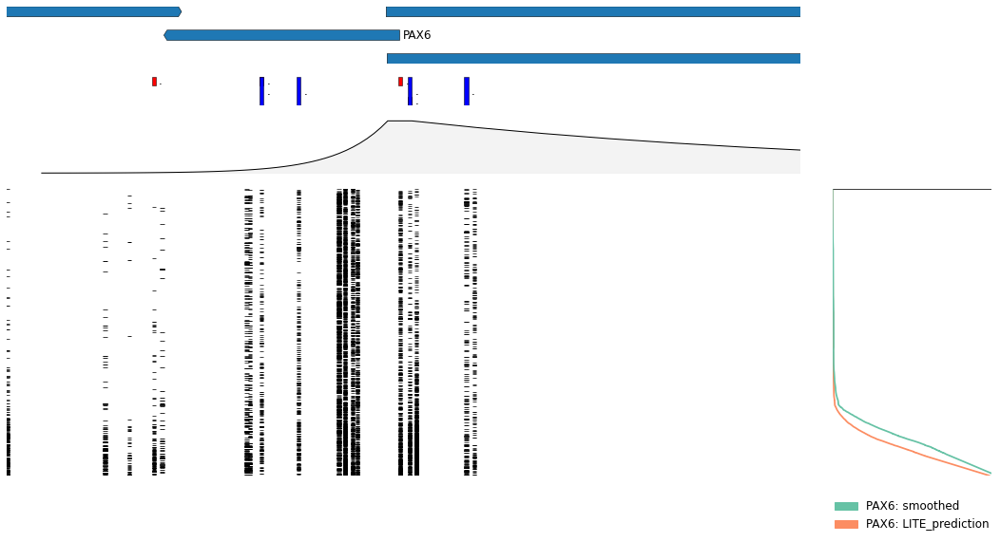

In [333]:
GENE = 'PAX6'
bounds = 0.2e5, 0.5e5
CHR, START, END = tss.loc[GENE].chromosome, tss.loc[GENE].txStart - bounds[0], tss.loc[GENE].txEnd + bounds[1]

#fig, ax = plt.subplots(1,1,figsize=(10,5))
cells = atac_data[rna_data.obs_names[(rna_data.obs.time != 'PS1') & rna_data.obs.tree_states.str.contains('PAX6') ]]
                                    #& (rna_data.obs.leiden != '0')]]

fig5 = plt.figure(constrained_layout=False, figsize=(15,8))
widths = [5, 1]
heights = [1, 0.5, 1, 5]
spec5 = fig5.add_gridspec(ncols=2, nrows=4, width_ratios=widths,
                    height_ratios=heights)

fragments_ax = fig5.add_subplot(spec5[-1,0])
for spine in ['left','right','top','bottom']:
    fragments_ax.spines[spine].set_visible(False)
fragments_ax.set(xticks = [], yticks = [])
_make_regpanel(fragments_ax, accessibility = cells.X, chrom = CHR, time = rna_data[cells.obs_names].obs.mira_pseudotime.values,
               start = START, end = END, peaks = cells.var[['chr','start','end']].values)


rp_axes = fig5.add_subplot(spec5[-2,0])
rp_axes.axis('off')
_plot_rp_models(rp_axes, 
        interval_chrom = CHR, interval_start = START, interval_end = END, rp_models = litemodel, 
        gene_id = atac_data.uns['TSS_metadata']['gene'], 
                chrom = atac_data.uns['TSS_metadata']['chromosome'], 
                start = atac_data.uns['TSS_metadata']['txStart'],
                end = atac_data.uns['TSS_metadata']['txEnd'], 
                strand = atac_data.uns['TSS_metadata']['strand'])
rp_axes.set(xlim = (START, END))

track = BedTrack(dict(file = 'data/hg38_tss.bed', section_name = 'Track'))
track_ax = fig5.add_subplot(spec5[0,0])
track_ax.set(xlim = (START, END))
track.plot(track_ax, CHR, START, END)
track_ax.axis('off')

neurod = BedTrack(dict(file = 'data/trackdata/ASCL1_chip_hits.bed', section_name = 'ASCL1', color = 'red', style = 'collapsed'))
track_ax = fig5.add_subplot(spec5[1,0])
track_ax.set(xlim = (START, END))
neurod.plot(track_ax, CHR, START, END)
track_ax.axis('off')

neurod = BedTrack(dict(file = 'data/trackdata/NEUROD1_chip_hits.bed', section_name = 'NEUROD1', color = 'blue', style = 'collapsed'))
track_ax = fig5.add_subplot(spec5[1,0])
track_ax.set(xlim = (START, END))
neurod.plot(track_ax, CHR, START, END)
track_ax.axis('off')

streamax = fig5.add_subplot(spec5[-1,1])
rna_cells = rna_data[cells.obs_names]
rna_cells.obs['ordered_cells'] = len(rna_cells) - rna_cells.obs.mira_pseudotime.argsort().argsort()
mira.pl.plot_stream(rna_cells, data = [GENE,GENE], layers = ['smoothed','LITE_prediction'],
                style = 'line', pseudotime_triangle=False, clip = 2, palette='Set2', max_bar_height = 0.99,
               window_size=1001, orientation='v', tree_structure=False, pseudotime_key = 'ordered_cells', 
                         log_pseudotime=False, scale_features = True, show_legend = True,legend_cols = 1,
                   ax = streamax)
streamax.set(ylim = (0, len(cells) + 1))
plt.savefig('data/analysis/{}_panel.png'.format(GENE))

array([[<AxesSubplot:title={'center':'Gene'}>,
        <AxesSubplot:title={'center':'Expression'}>,
        <AxesSubplot:title={'center':'Local Prediction'}>,
        <AxesSubplot:title={'center':'Chromatin Differential'}>,
        <AxesSubplot:title={'center':'LITE vs. NITE Predictions'}, xlabel='NITE Prediction', ylabel='LITE Prediction'>]],
      dtype=object)

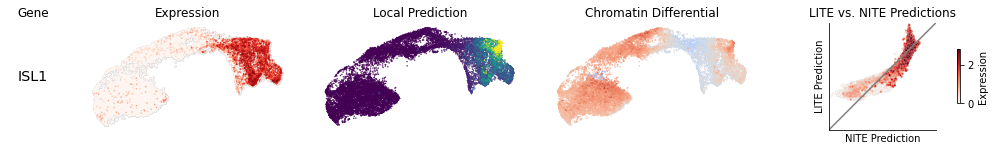

In [332]:
mira.pl.plot_chromatin_differential(rna_data, genes = 'ISL1', size = 0.2, height = 2.2, add_legend=False, 
                                   differential_range=5)

(<Figure size 360x216 with 1 Axes>, <AxesSubplot:>)

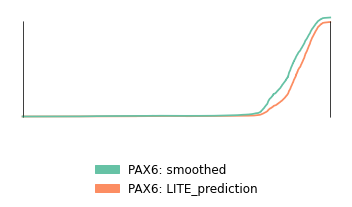

In [330]:
mira.pl.plot_stream(rna_cells, data = ['PAX6','PAX6'], layers = ['smoothed','LITE_prediction'],
                style = 'line', pseudotime_triangle=False, clip = 2, palette='Set2', max_bar_height = 0.99,
               window_size=1001, orientation='h', tree_structure=False, pseudotime_key = 'mira_pseudotime', 
                         log_pseudotime=False, scale_features = True, show_legend = True,legend_cols = 1, figsize=(5,3))

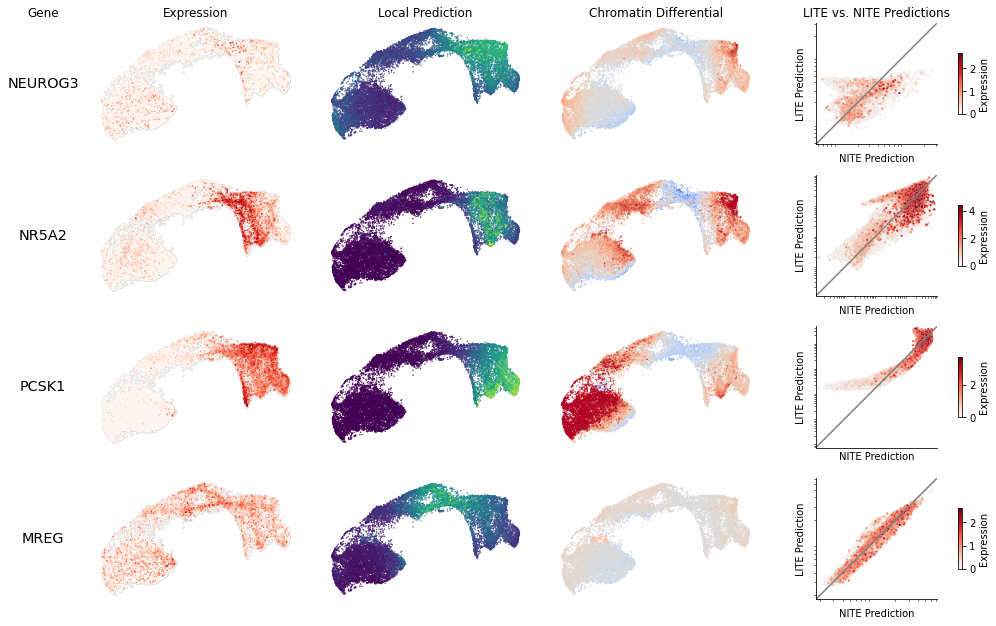

In [196]:
mira.pl.plot_chromatin_differential(rna_data, genes = ['NEUROG3','NR5A2','PCSK1','MREG'],
                                    size = 0.2, height = 2.2, add_legend=False)
plt.show()

In [191]:
blah = isd_matrix.loc[np.intersect1d(rna_model.get_top_genes(19, 400), isd_matrix.index), ['ASCL1','NEUROD1']].iloc[:,[0,2]].sort_values('ASCL1').tail(50)

In [193]:
blah

,ASCL1,NEUROD1
TMX4,16.415910,28.504395
NR5A2,16.780391,10.991850
HMGB3,17.442214,11.474100
PDE3B,17.826491,3.970940
CHRM3,17.954180,64.467053
HMGB2,19.624604,4.888419
DUSP6,20.017895,39.149782
TENT5A,20.071922,37.716005
SEMA5A,20.939445,6.726000
SLC36A1,22.532724,1.915645


In [122]:
from IPython import display

In [129]:
!ls data/analysis/*_panel.png

data/analysis/ASCL1_panel.png	 data/analysis/NR5A2_panel.png
data/analysis/GPRIN3_panel.png	 data/analysis/PAX6_panel.png
data/analysis/NEUROD1_panel.png  data/analysis/SMOC2_panel.png
data/analysis/NEUROG3_panel.png


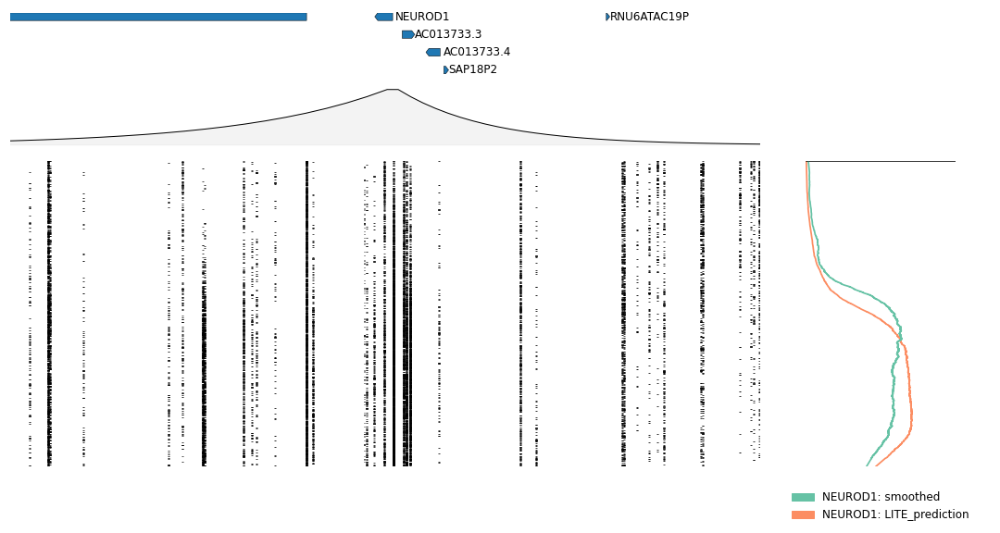

In [133]:
display.Image('data/analysis/NEUROD1_panel.png')

In [134]:
litemodel.get_model('NEUROD1').get_normalized_params()

{'a': array([1.4489397 , 0.34272224, 0.9759927 ], dtype=float32),
 'distance': array([16.899864, 27.568953], dtype=float32),
 'theta': array(1.4683409, dtype=float32),
 'gamma': array(1.4798442, dtype=float32),
 'bias': array(-0.33819452, dtype=float32),
 'bn_mean': array([0.45813748], dtype=float32),
 'bn_var': array([0.09476197], dtype=float32),
 'bn_eps': 1e-05}

# Day2/3 branch pseudotime

In [174]:
day2_data = rna_data[rna_data.obs.mira_pseudotime < 10].copy()

In [175]:
sc.pp.neighbors(day2_data, use_rep='X_joint_umap_features', metric='manhattan')

INFO:root:Added key to obsm: X_diffmap, normalized diffmap with 14 components.
INFO:root:Added key to uns: eigen_gap


Recommending 2 diffusion map components.


/liulab/alynch/projects/multiomics/endocrine/MIRA/mira/plots/eigengap_plot.py:52: UserWarning:

color is redundantly defined by the 'color' keyword argument and the fmt string "--bo" (-> color='b'). The keyword argument will take precedence.



(<Figure size 504x288 with 2 Axes>,
 <Figure size 1080x432 with 15 Axes>,
 array([<AxesSubplot:ylabel='Eigenvalues'>,
        <AxesSubplot:xlabel='Num Components', ylabel='Eigen Gap'>],
       dtype=object),
 array([[<AxesSubplot:title={'center':'Component 1'}>,
         <AxesSubplot:title={'center':'Component 2'}>,
         <AxesSubplot:title={'center':'Component 3'}>,
         <AxesSubplot:title={'center':'Component 4'}>,
         <AxesSubplot:title={'center':'Component 5'}>],
        [<AxesSubplot:title={'center':'Component 6'}>,
         <AxesSubplot:title={'center':'Component 7'}>,
         <AxesSubplot:title={'center':'Component 8'}>,
         <AxesSubplot:title={'center':'Component 9'}>,
         <AxesSubplot:title={'center':'Component 10'}>],
        [<AxesSubplot:title={'center':'Component 11'}>,
         <AxesSubplot:title={'center':'Component 12'}>,
         <AxesSubplot:title={'center':'Component 13'}>,
         <AxesSubplot:title={'center':'Component 14'}>, <AxesSubplot:>]

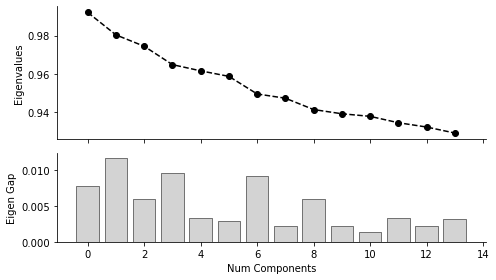

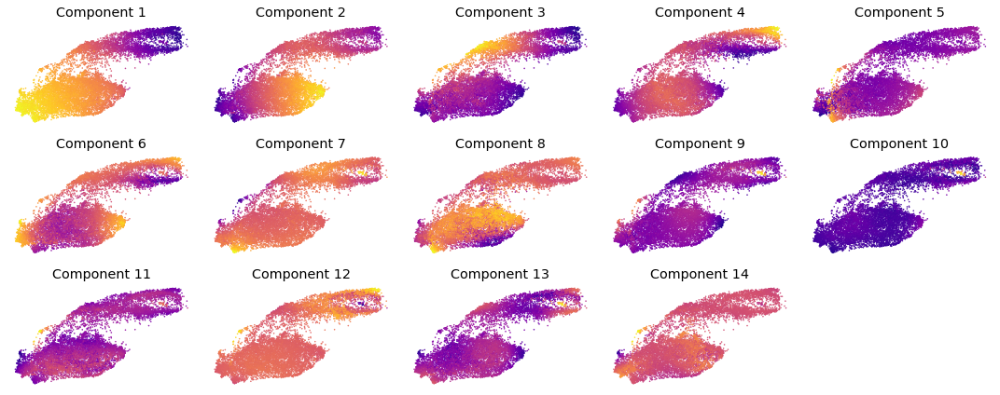

In [176]:
sc.tl.diffmap(day2_data)
mira.time.normalize_diffmap(day2_data)
mira.pl.plot_eigengap(day2_data)

In [229]:
sc.pp.neighbors(day2_data, use_rep='X_diffmap', key_added='X_diffmap', n_pcs = 4)

In [230]:
mira.time.get_transport_map(day2_data, start_cell = rna_data.uns['start_cell'])

INFO:mira.pseudotime.pseudotime:Calculating inter-cell distances ...
INFO:root:Using 1 core. Speed this up by allocating more n_jobs.
Calculating pseudotime:   8%|███████████████████████▌                                                                                                                                                                                                                                                                              | 4747/59325 [00:01<00:19, 2846.38it/s]
INFO:mira.pseudotime.pseudotime:Calculating transport map ...
INFO:mira.adata_interface.pseudotime:Added key to obs: mira_pseudotime
INFO:mira.adata_interface.pseudotime:Added key to obsp: transport_map
INFO:mira.adata_interface.pseudotime:Added key to uns: start_cell


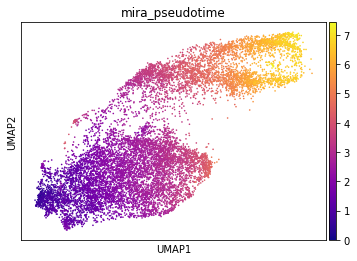

In [231]:
sc.pl.umap(day2_data, color = 'mira_pseudotime', color_map='plasma')

In [232]:
terminal_cells = mira.time.find_terminal_cells(day2_data)
terminal_cells = ['TCAGGTCCAGGACACA-PS3','TCGCTAACAATCGCAC-PS5']

INFO:mira.pseudotime.pseudotime:Found 5 terminal states from stationary distribution.


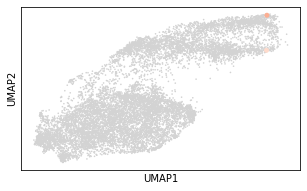

In [233]:
fig, ax = plt.subplots(1,1,figsize=(5,3))
sc.pl.umap(day2_data, ax = ax, show = False, na_color = 'lightgrey')
for i, terminal_cell in enumerate(terminal_cells):
    sc.pl.umap(day2_data[terminal_cell], ax = ax, show = False, na_color = sns.color_palette('Reds')[i], size = 100)
plt.show()

In [234]:
mira.time.get_branch_probabilities(day2_data, terminal_cells=dict(zip(['Immune','Hippo'], terminal_cells)))

INFO:mira.pseudotime.pseudotime:Simulating random walks ...
INFO:mira.adata_interface.pseudotime:Added key to obsm: branch_probs
INFO:mira.adata_interface.pseudotime:Added key to uns: lineage_names
INFO:mira.adata_interface.core:Added cols to obs: Immune_prob
INFO:mira.adata_interface.core:Added cols to obs: Hippo_prob
INFO:mira.adata_interface.core:Added cols to obs: differentiation_entropy


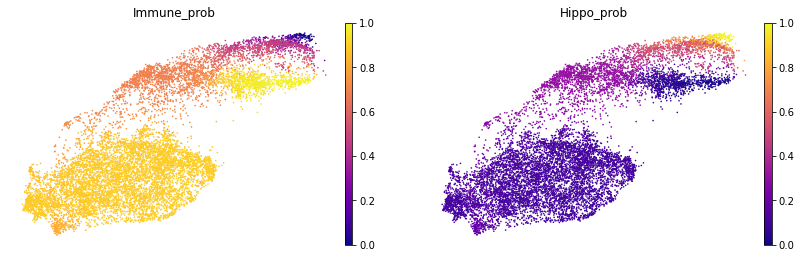

In [235]:
sc.pl.umap(day2_data, color = ['Immune_prob','Hippo_prob'], frameon = False, color_map = 'plasma')

INFO:mira.adata_interface.pseudotime:Added key to obs: tree_states
INFO:mira.adata_interface.pseudotime:Added key to uns: tree_state_names
INFO:mira.adata_interface.pseudotime:Added key to uns: connectivities_tree
/liulab/alynch/projects/cuda/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning:

The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.

... storing 'tree_states' as categorical


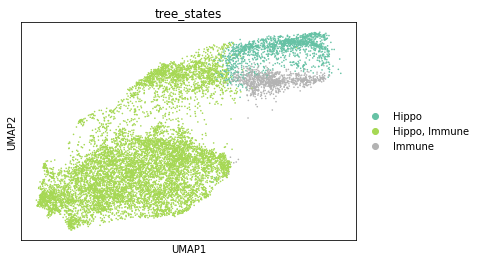

In [292]:
mira.time.get_tree_structure(day2_data, threshold=0.2)
sc.pl.umap(day2_data, color = 'tree_states', palette='Set2')

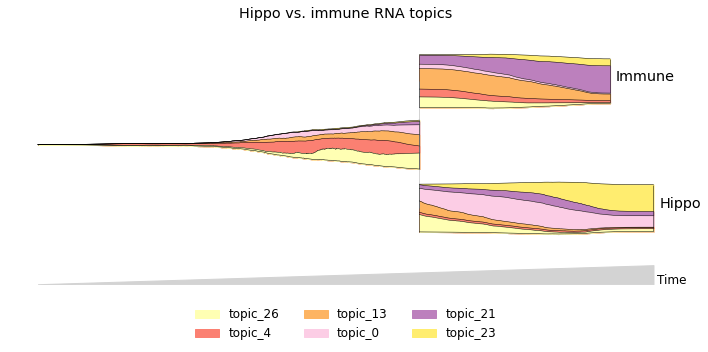

In [302]:
fig, ax = mira.pl.plot_stream(day2_data, 
                    data = ['topic_' + str(i) for i in [26,4,0,13,21,23]], hide_feature_threshold=0.03,
                   window_size=501, log_pseudotime=False, legend_cols=3, title = 'Hippo vs. immune RNA topics',
                             palette=sns.color_palette('Set3')[1::2], linewidth=0.5,)
plt.savefig('data/analysis/2022-01-11_hippo_immune_rna_topic_streams.svg')

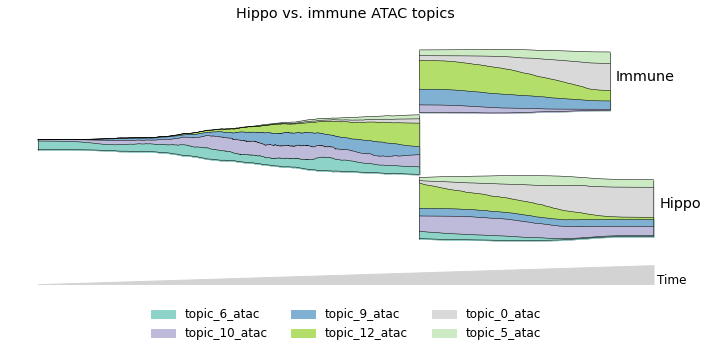

In [301]:
fig, ax = mira.pl.plot_stream(day2_data, 
                    data = ['topic_' + str(t) + '_atac' for t in [9,12,10,5,6,0]], hide_feature_threshold=0.03,
                   window_size=501, log_pseudotime=False, legend_cols=3, title = 'Hippo vs. immune ATAC topics',
                             palette=sns.color_palette('Set3')[::2], linewidth=0.5)
plt.savefig('data/analysis/2022-01-11_hippo_immune_atac_topic_streams.svg')